<a href="https://colab.research.google.com/github/sakalaharshith/Leaf_Disease_Detection_instance_Segmentation/blob/main/instance_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Cloning MaskRCNN depository from github
!git clone "https://github.com/matterport/Mask_RCNN.git"

Cloning into 'Mask_RCNN'...
remote: Enumerating objects: 956, done.
remote: Total 956 (delta 0), reused 0 (delta 0), pack-reused 956
Receiving objects: 100% (956/956), 137.67 MiB | 15.44 MiB/s, done.
Resolving deltas: 100% (558/558), done.


In [ ]:
# Installing tensorflow1 library that supports gpu 
!pip install keras==2.2.5
!pip install tensorflow_gpu==1.15.5


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 336 kB 14.1 MB/s 
     |████████████████████████████████| 50 kB 7.6 MB/s 
  Attempting uninstall: keras
    Found existing installation: keras 2.8.0
    Uninstalling keras-2.8.0:
      Successfully uninstalled keras-2.8.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires keras<2.9,>=2.8.0rc0, but you have keras 2.2.5 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 411.0 MB 24 kB/s 
     |████████████████████████████████| 3.8 MB 76.2 MB/s 
     |████████████████████████████████| 2.9 MB 73.7 MB/s 
     |████████████████████████████████| 20.1 MB 79.0 MB/s 
     |███████

In [ ]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0


In [ ]:
# Importing necessary libraries
import os
import sys
import json
import datetime
import numpy as np
import skimage.draw 
import cv2
from mrcnn.visualize import display_instances
import matplotlib.pyplot as plt
from mrcnn.config import Config
import model as modellib
from mrcnn import utils
from model import MeanAveragePrecisionCallback
import random
from mrcnn import visualize
from mrcnn.visualize import display_images
from mrcnn.visualize import display_instances
import matplotlib.patches as patches
import matplotlib.image as mpimg
import imgaug


Using TensorFlow backend.


In [ ]:
#Unzipping annotated dataset
from zipfile import ZipFile
foldername="dataset3.zip"

with ZipFile(foldername,'r') as zip:
  zip.extractall()
  print("done")

done


In [ ]:
#Unzipping images(white background) file
from zipfile import ZipFile
foldername="without_background.zip"
with ZipFile(foldername,'r') as zip:
  zip.extractall()
  print("done")

done


In [ ]:
from zipfile import ZipFile
foldername="/content/images from online sources.zip"

with ZipFile(foldername,'r') as zip:
  zip.extractall()
  print("done")

done


In [ ]:
# Creating path variable for MaskRCNN folder
Root_directory="/content/Mask_RCNN"
sys.path.append(Root_directory)

In [ ]:
# Creating path variable for coco weights and logs to save weights file
coco_weights_path=os.path.join(Root_directory,"mask_rcnn_coco.h5")
model_logs=os.path.join(Root_directory,"logs")

In [ ]:
# Creating Custom Config class which specifies training and testing parameters of the model
class CustomConfig(Config):
  NAME="object"
  IMAGES_PER_GPU=2
  NUM_CLASSES=1+6
  STEPS_PER_EPOCH=11
  DETECTION_MIN_CONFIDENCE=0.9
  LEARNING_RATE = 0.001
# Creating Custom Dataset that actually associates  images with annotation json files  
class CustomDataset(utils.Dataset):
  def load_custom(self,dataset_dir,subset):
    self.add_class("object",1,"Apple_Black_rot")
    self.add_class("object",2,"Grape_Black_rot")
    self.add_class("object",3,"Apple_healthy")
    self.add_class("object",4,"Grape_healthy")
    self.add_class("object",5,"Potato_healthy")
    self.add_class("object",6,"Potato_Late_blight")

    
    if subset=="train":
     
      dataset_dir=os.path.join(dataset_dir,"training_apple_black_rot")
      json_file="annotation_training.json"


    elif subset=="test":
      
      dataset_dir=os.path.join(dataset_dir,"testing_apple_black_rot")
      json_file="testing_annotation.json"
    else:
      sys.exit()
    
    annotations1=json.load(open(os.path.join(dataset_dir,json_file)))
    annotations=list(annotations1.values())
    annotations=[a for a in annotations if a['regions']]
    for a in annotations:
       polygons = [r['shape_attributes'] for r in a['regions']] 
       objects = [s['region_attributes']['names'] for s in a['regions']]
       print("objects:",objects)
       name_dict = {"Apple_Black_rot": 1,"Grape_Black_rot": 2,"Apple_healthy":3,"Grape_healthy":4,"Potato_healthy":5,"Potato_Late_blight":6}
       num_ids = [name_dict[a] for a in objects]
       print("numids",num_ids)
       image_path = os.path.join(dataset_dir, a['filename'])
       image = skimage.io.imread(image_path)
       height, width = image.shape[:2]
       self.add_image(
                "object",  
                image_id=a['filename'],  
                path=image_path,
                width=width, height=height,
                polygons=polygons,
                num_ids=num_ids
                )
  def load_mask(self, image_id):
        """Generate instance masks for an image.
       Returns:
        masks: A bool array of shape [height, width, instance count] with
            one mask per instance.
        class_ids: a 1D array of class IDs of the instance masks.
        """
       
        image_info = self.image_info[image_id]
        if image_info["source"] != "object":
            return super(self.__class__, self).load_mask(image_id)

      
        info = self.image_info[image_id]
        if info["source"] != "object":
            return super(self.__class__, self).load_mask(image_id)
        num_ids = info['num_ids']
        mask = np.zeros([info["height"], info["width"], len(info["polygons"])],
                        dtype=np.uint8)
        for i, p in enumerate(info["polygons"]):
            
        	rr, cc = skimage.draw.polygon(p['all_points_y'], p['all_points_x'])

        	mask[rr, cc, i] = 1

        
        num_ids = np.array(num_ids, dtype=np.int32)
        return mask, num_ids 
  def image_reference(self, image_id):
        
        info = self.image_info[image_id]
        if info["source"] == "object":
            return info["path"]
        else:
            super(self.__class__, self).image_reference(image_id)
        
       

In [ ]:
# Creating train method that helps to instantiate training and validation objects of Custom Dataset and trains the model using those objects

import warnings 
warnings.filterwarnings("ignore")
from keras.callbacks import TensorBoard
x_epoch=[]
y_tra_loss=[]
y_val_loss=[]
def train(model): 
   
    dataset_train = CustomDataset()
    dataset_train.load_custom("/content/New folder (4)/selectedimages/train", "train")
    dataset_train.prepare()

   
    dataset_val = CustomDataset()
    dataset_val.load_custom("/content/New folder (4)/selectedimages/test", "test")
    dataset_val.prepare()

  
    mean_average_precision_callback = modellib.MeanAveragePrecisionCallback(model,
model_inference, dataset_val, calculate_map_at_every_X_epoch=2, verbose=1)
    augmentation=imgaug.augmenters.Sometimes(0.5,[imgaug.augmenters.Fliplr(0.5),imgaug.augmenters.Flipud(0.5)])
    
    model.train(dataset_train, dataset_val,
                learning_rate=config1.LEARNING_RATE,
                epochs=400,
                layers='all',custom_callbacks=[mean_average_precision_callback,TensorBoard("/content/Mask_RCNN/tensorboard")],augmentation=augmentation)
  
    

In [ ]:
#Creating a model object and associating that model with training and testing data to train model				
config1 = CustomConfig()
model = modellib.MaskRCNN(mode="training", config=config1,model_dir=model_logs)

weights_path = coco_weights_path
        
if not os.path.exists(weights_path):
  utils.download_trained_weights(weights_path)

model.load_weights(coco_weights_path, by_name=True, exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",
            "mrcnn_bbox", "mrcnn_mask"])

train(model)

objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['A

Epoch 1/400
11/11 [==============================] - 77s 7s/step - loss: 3.8929 - rpn_class_loss: 0.0421 - rpn_bbox_loss: 1.0182 - mrcnn_class_loss: 0.8916 - mrcnn_bbox_loss: 1.0316 - mrcnn_mask_loss: 0.9093 - val_loss: 2.8802 - val_rpn_class_loss: 0.0985 - val_rpn_bbox_loss: 0.4860 - val_mrcnn_class_loss: 0.7126 - val_mrcnn_bbox_loss: 1.1534 - val_mrcnn_mask_loss: 0.4296



Process ForkPoolWorker-15:
Process ForkPoolWorker-16:
Process ForkPoolWorker-12:
Process ForkPoolWorker-14:
Process ForkPoolWorker-9:
Process ForkPoolWorker-8:
Process ForkPoolWorker-13:
Process ForkPoolWorker-6:
Process ForkPoolWorker-11:
Process ForkPoolWorker-5:
Traceback (most recent call last):
Process ForkPoolWorker-3:
Traceback (most recent call last):
Process ForkPoolWorker-2:
Traceback (most recent call last):
  File "/usr/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/usr/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/usr/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/usr/lib/python3.7/multiprocessing/process.py", line 99, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
Process ForkPoolWorker-1:
  File "/usr/lib/python3.7/multiprocessing/process.py", line 99, in run
    s

KeyboardInterrupt: ignored

In [ ]:
# TensorBoard is used to monitor the model performance across epochs
from keras.callbacks import TensorBoard
#!kill 1933
%load_ext tensorboard
%tensorboard --logdir="/content/"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2251), started 0:07:49 ago. (Use '!kill 2251' to kill it.)

In [ ]:
model.load_weights(model.find_last(), by_name=True)
train(model)

Re-starting from epoch 200
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_health

In [ ]:
TEST_MODE = "inference"
ROOT_DIR = "/content/New folder (4)/selectedimages/test"

def get_ax(rows=1, cols=1, size=16):
  _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
  return ax


CUSTOM_DIR = "/content/New folder (4)/selectedimages/test"
dataset = CustomDataset()
dataset.load_custom(CUSTOM_DIR, "test")

dataset.prepare()
print("Images: {}\nClasses: {}".format(len(dataset.image_ids), dataset.class_names))

objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
obj

In [ ]:
#creating testing configuration object for testing images and displaying results
class test_CustomConfig(Config):
  NAME="object"
  IMAGES_PER_GPU=1
  NUM_CLASSES=1+6
  STEPS_PER_EPOCH=10
  DETECTION_MIN_CONFIDENCE=0.9
config = test_CustomConfig()

model_inference = modellib.MaskRCNN(mode="inference", model_dir=model_logs, config=config)

model_inference.load_weights("/content/mask_rcnn_object_0342.h5", by_name=True)

image id is : 24
image ID: object.Potato_healthy(438).JPG (24) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_healthy(438).JPG
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  133.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
[[0.89934355]]


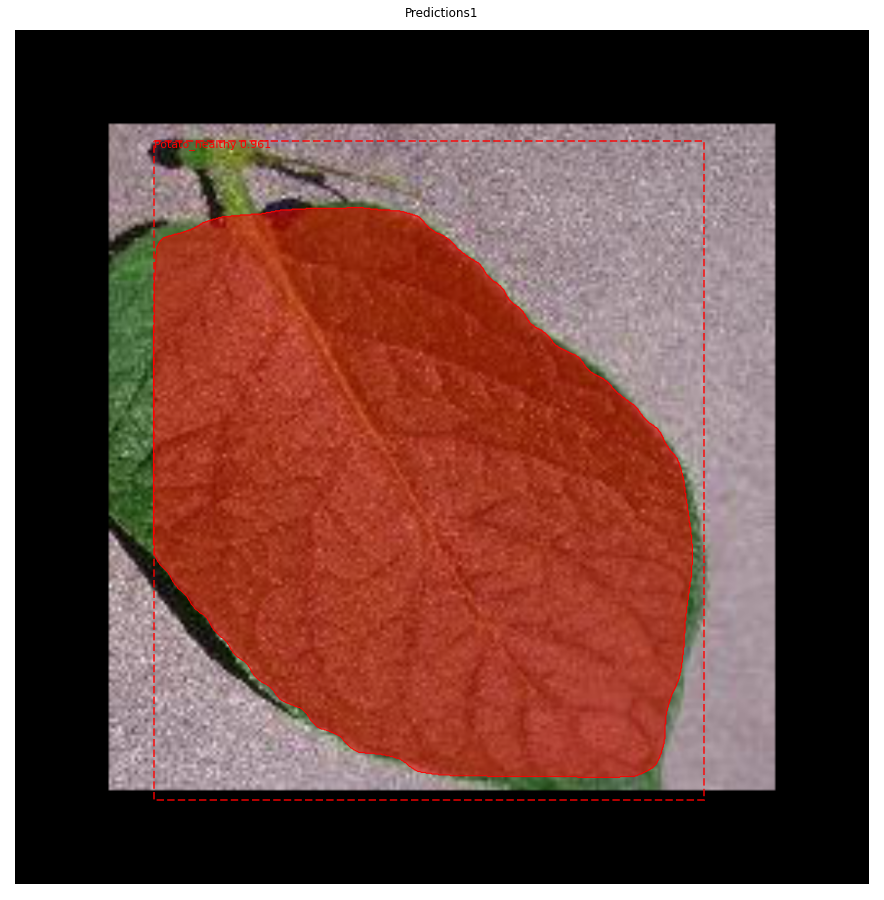

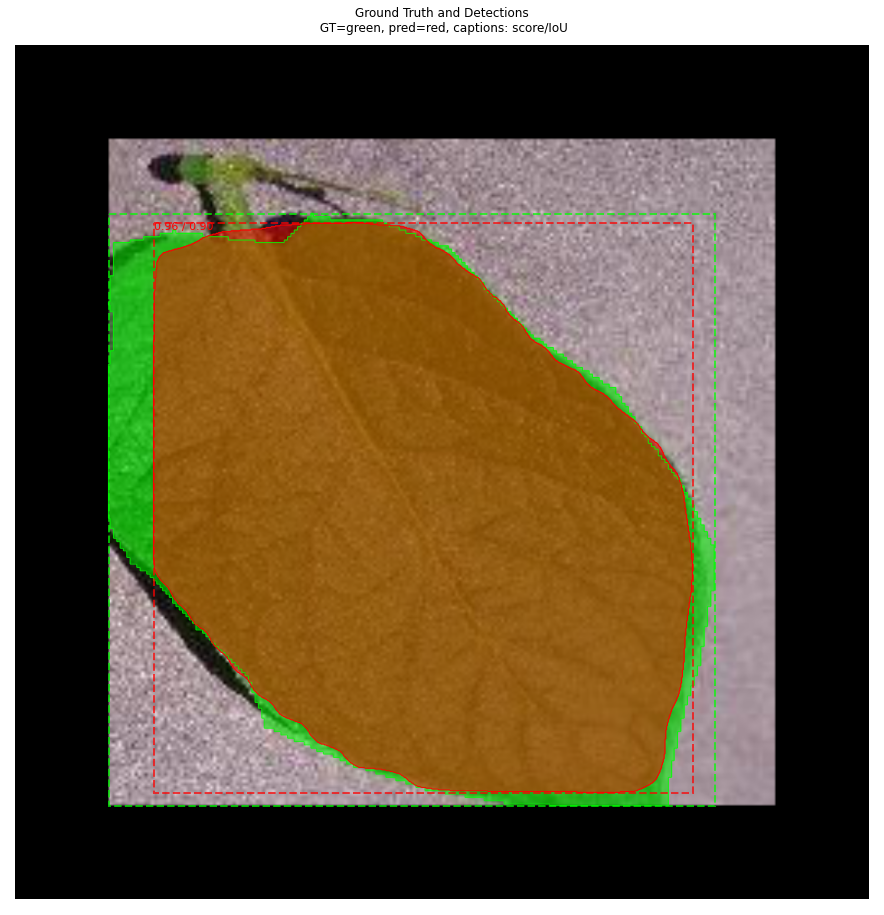

In [ ]:
# Result of Randomly choosen image from validation dataset
image_id = random.choice(dataset.image_ids)

print("image id is :",image_id)

image, image_meta, gt_class_id, gt_bbox, gt_mask =\
modellib.load_image_gt(dataset,config,image_id,use_mini_mask=False)
info = dataset.image_info[image_id]

print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id,dataset.image_reference(image_id)))

results = model_inference.detect([image], verbose=1)
ax = get_ax(1)
r1 = results[0]
visualize.display_instances(image, r1['rois'], r1['masks'], r1['class_ids'],
 dataset.class_names, r1['scores'], ax=ax, title="Predictions1")
iou=utils.compute_overlaps_masks(r1['masks'],gt_mask)
print(iou)
pred_boxes=utils.extract_bboxes(r1['masks'])

visualize.display_differences(image,gt_bbox,gt_class_id,gt_mask,pred_boxes,r1['class_ids'],r1['scores'],r1['masks'],dataset.class_names)

image id is : 36
image ID: object.Grape_Black_rot (506).JPG (36) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (506).JPG
gt_class_id [2 2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  121.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.9000000009934108
iou dimensions 3.8043156


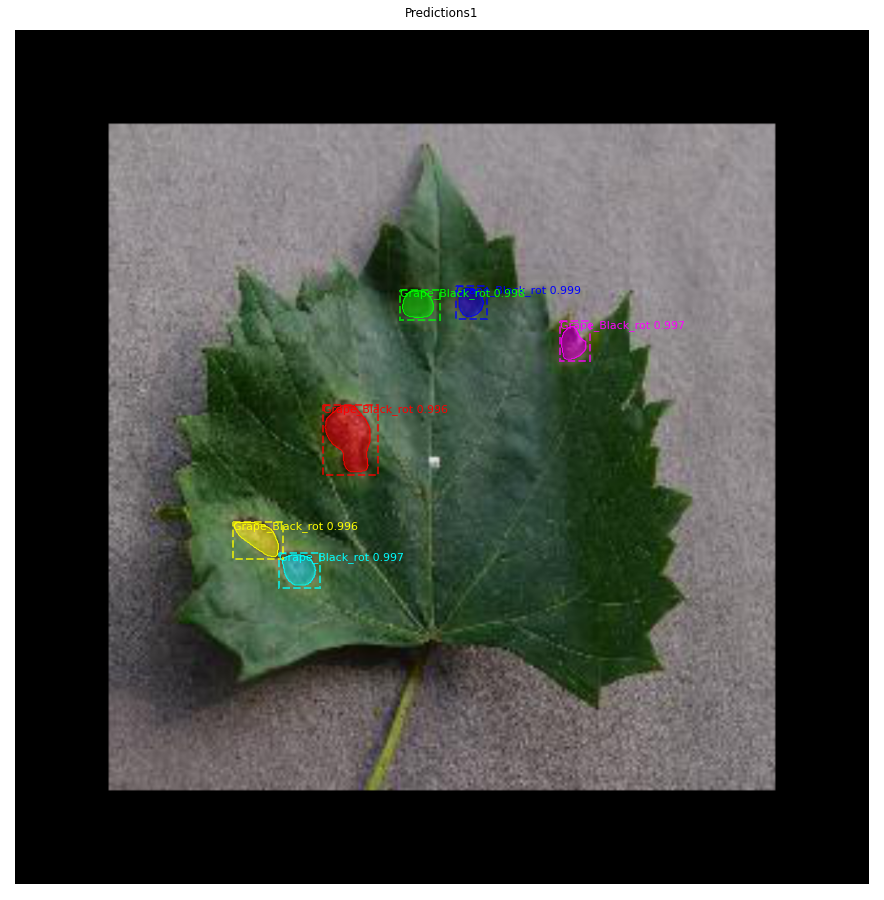

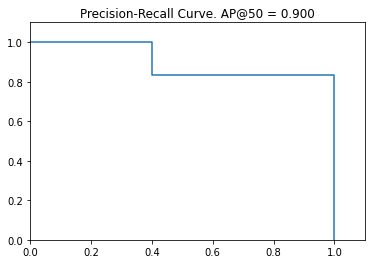

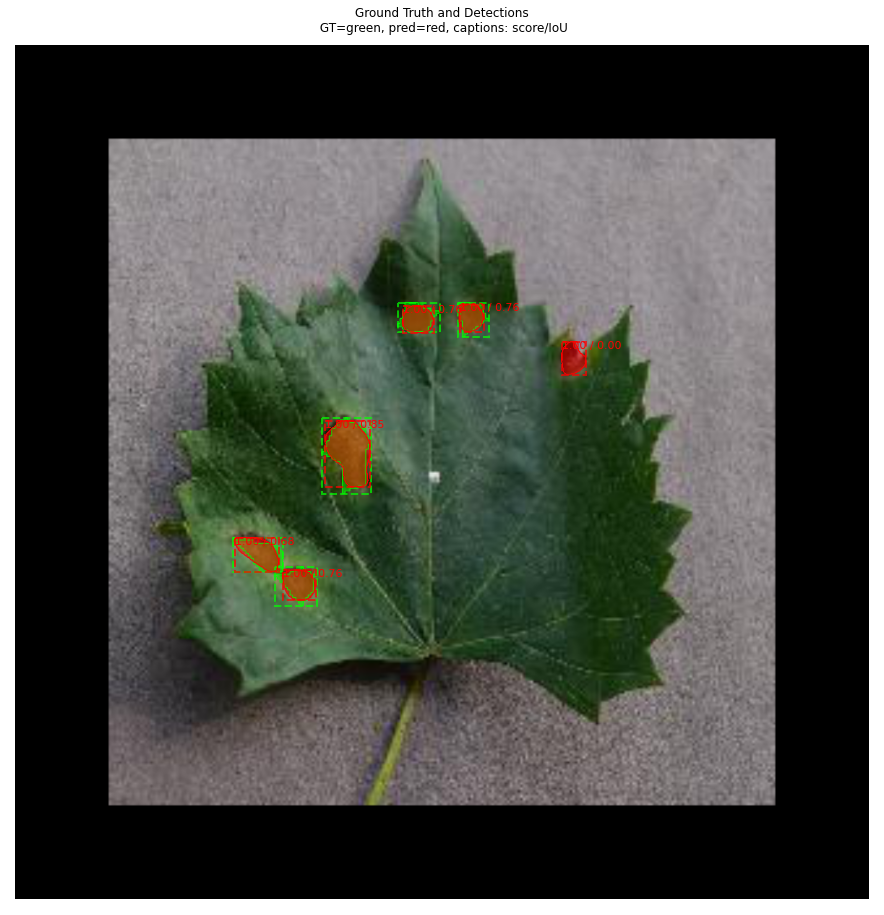

image id is : 37
image ID: object.Grape_Black_rot (508).JPG (37) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (508).JPG
gt_class_id [2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  205.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   81.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 3.43091


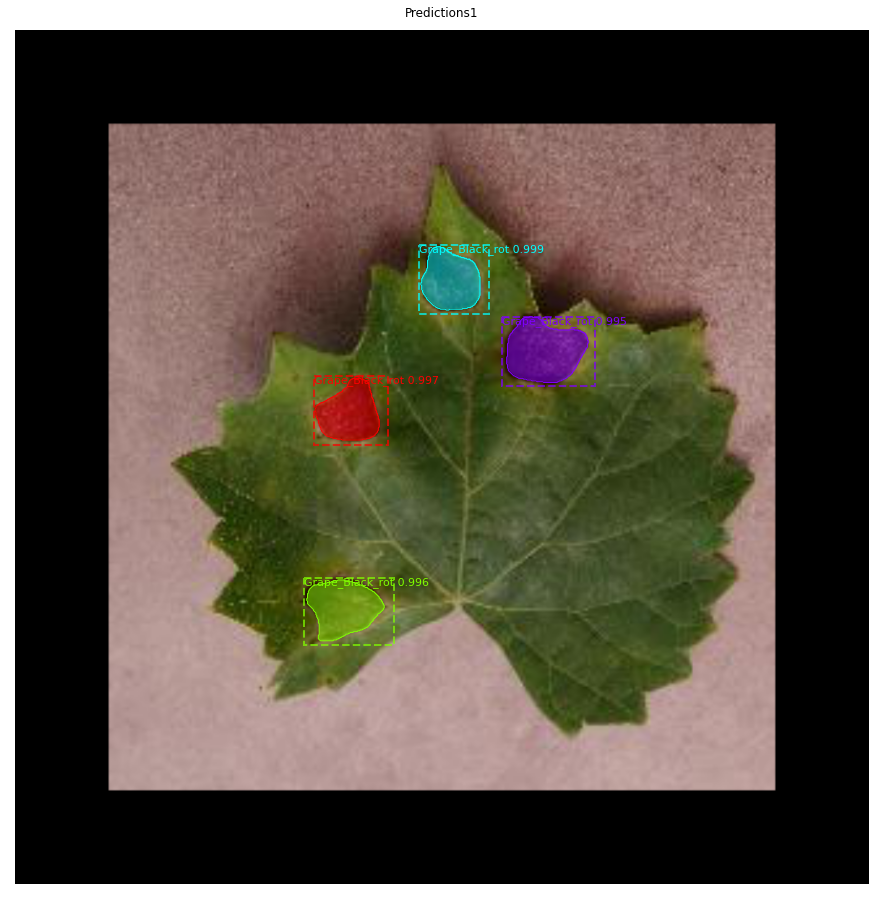

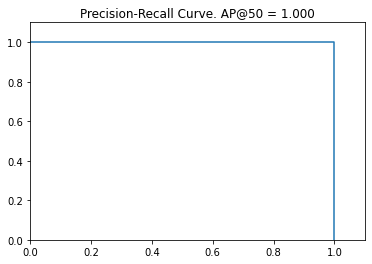

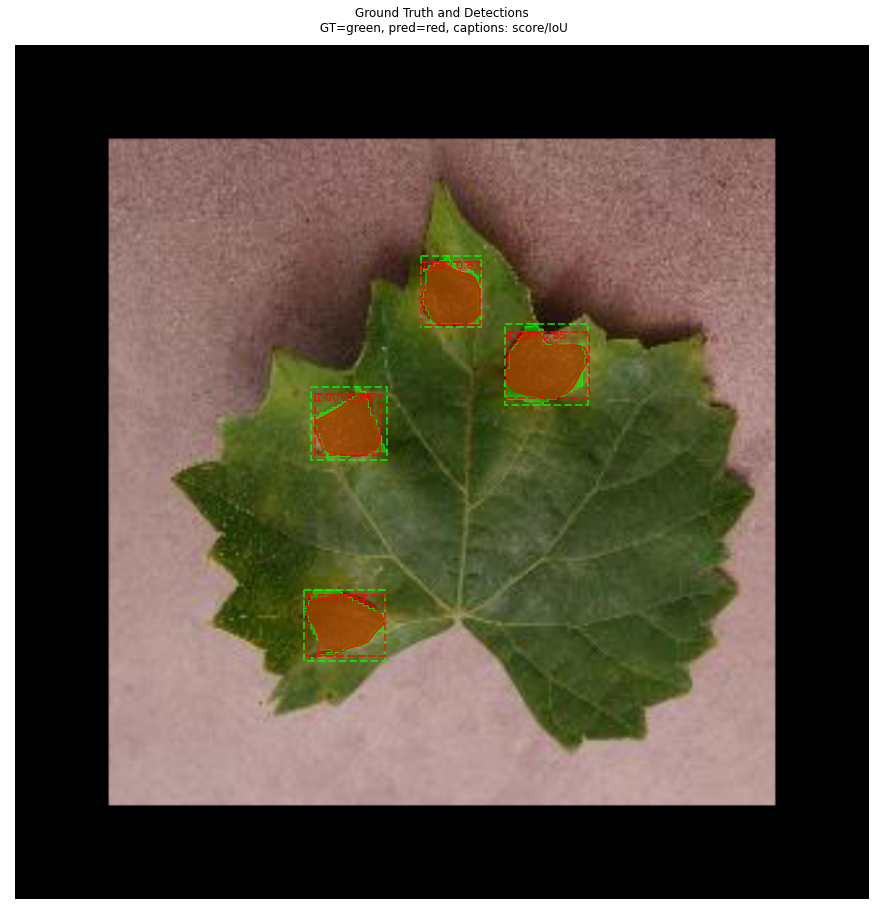

image id is : 38
image ID: object.Grape_Black_rot (511).JPG (38) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (511).JPG
gt_class_id [2 2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  239.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  117.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 3.9601135


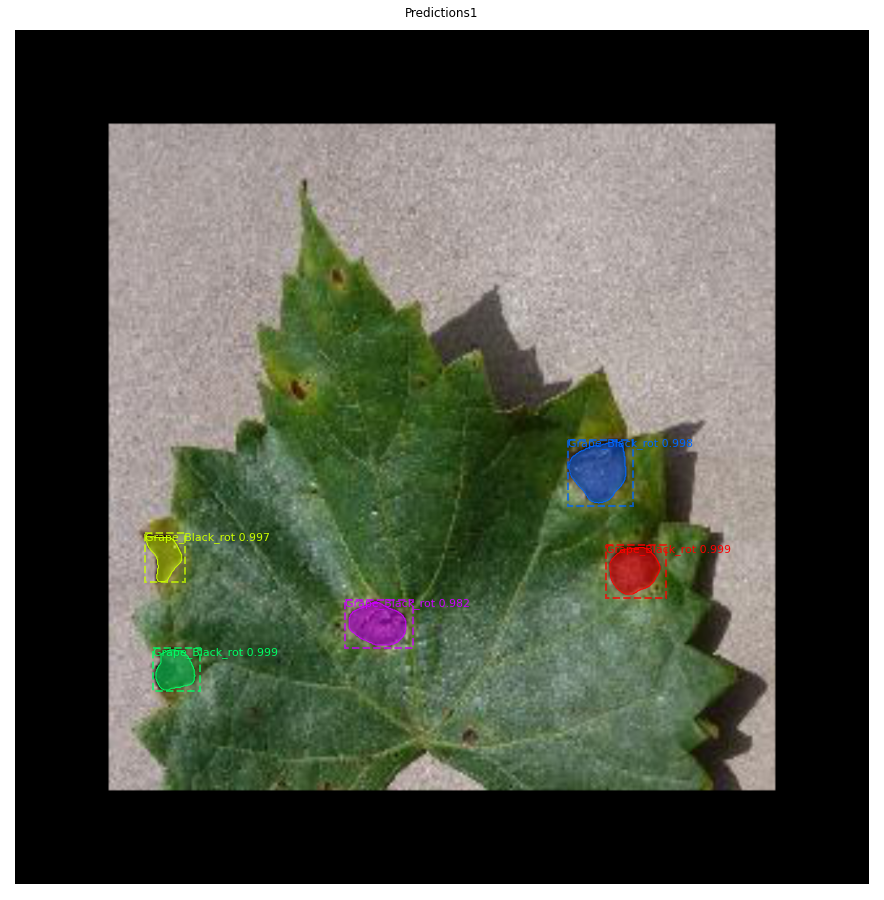

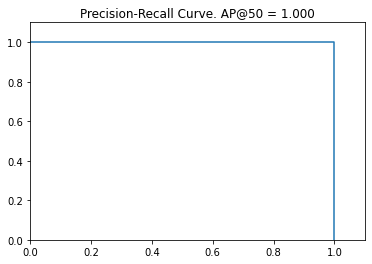

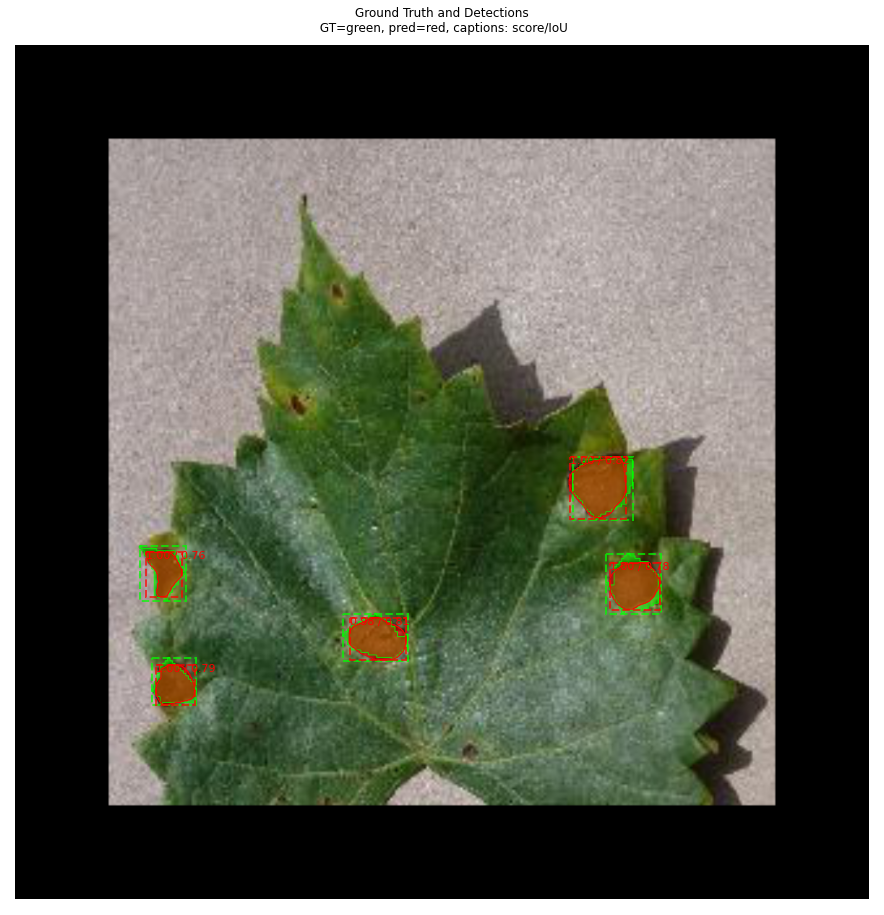

image id is : 39
image ID: object.Grape_Black_rot (512).JPG (39) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (512).JPG
gt_class_id [2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  235.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  118.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 0.859258


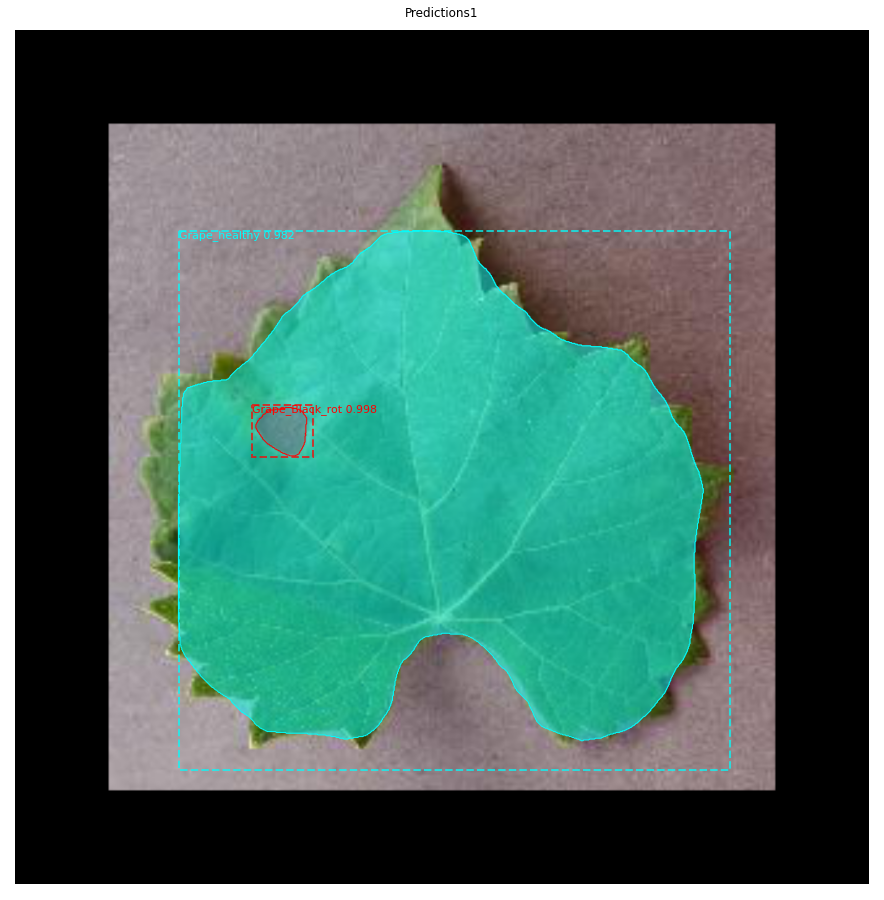

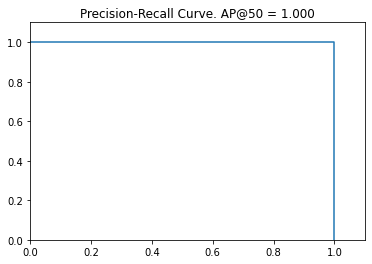

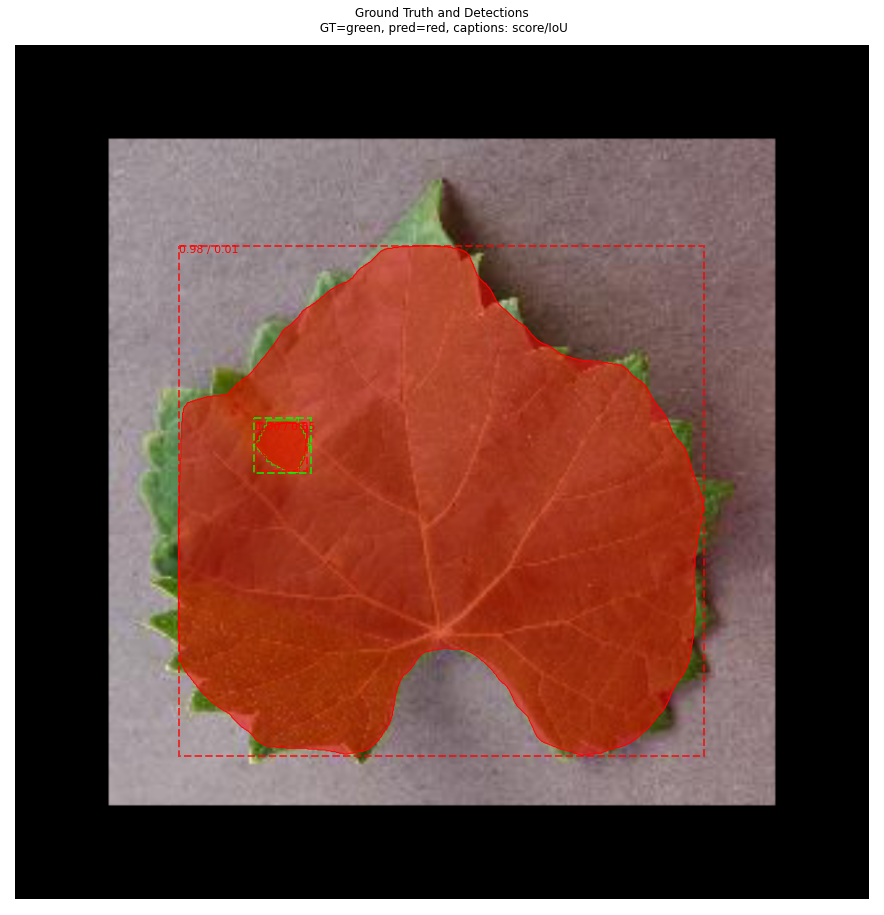

image id is : 40
image ID: object.Grape_Black_rot (513).JPG (40) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (513).JPG
gt_class_id [2 2 2 1]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  203.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   99.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.625
iou dimensions 3.017155


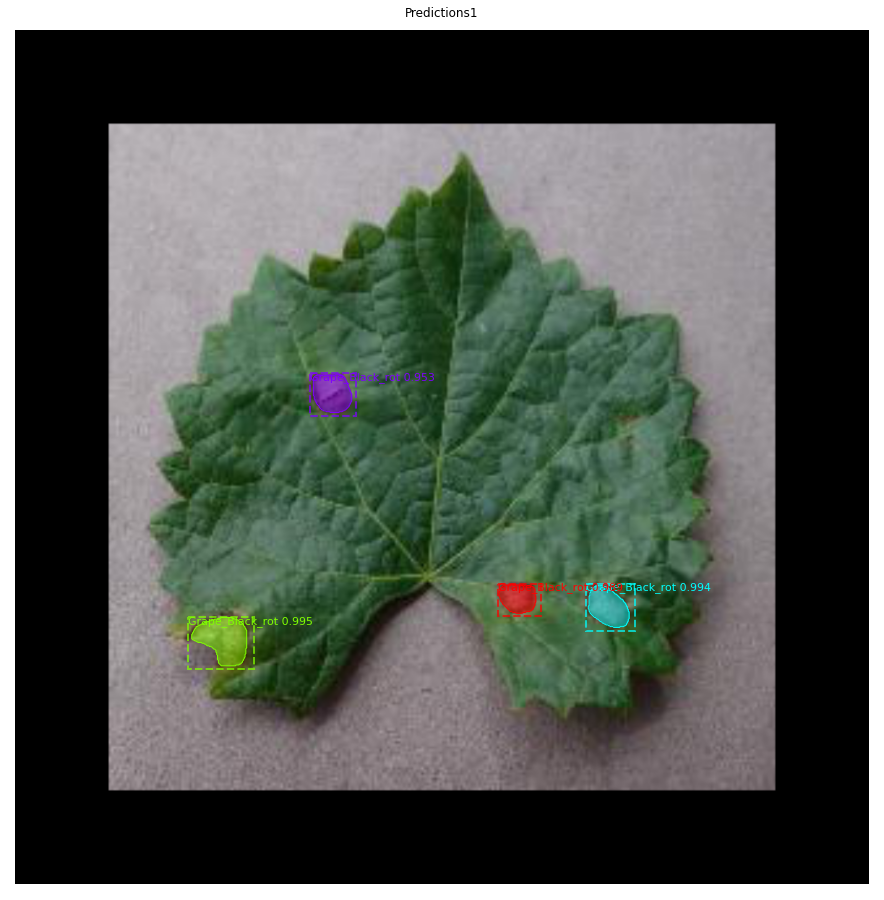

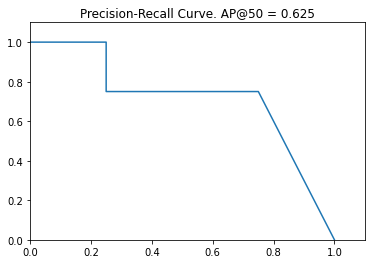

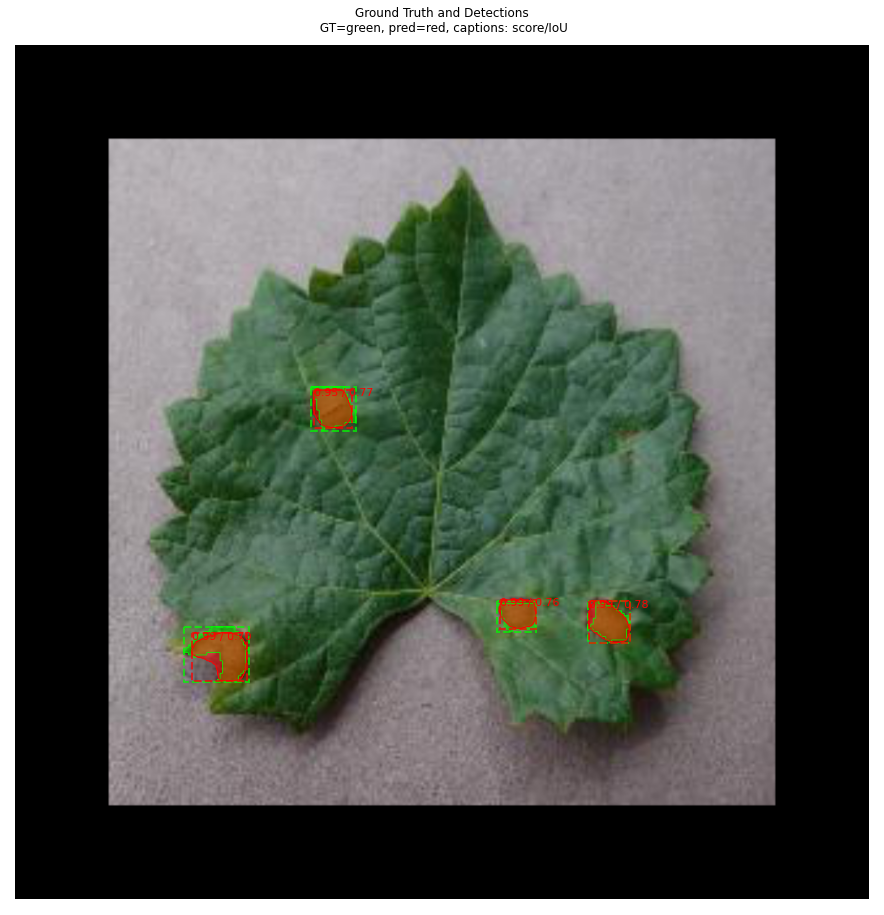

image id is : 41
image ID: object.Grape_Black_rot (516).JPG (41) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (516).JPG
gt_class_id [2 2 2 2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  207.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   90.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 5.416948


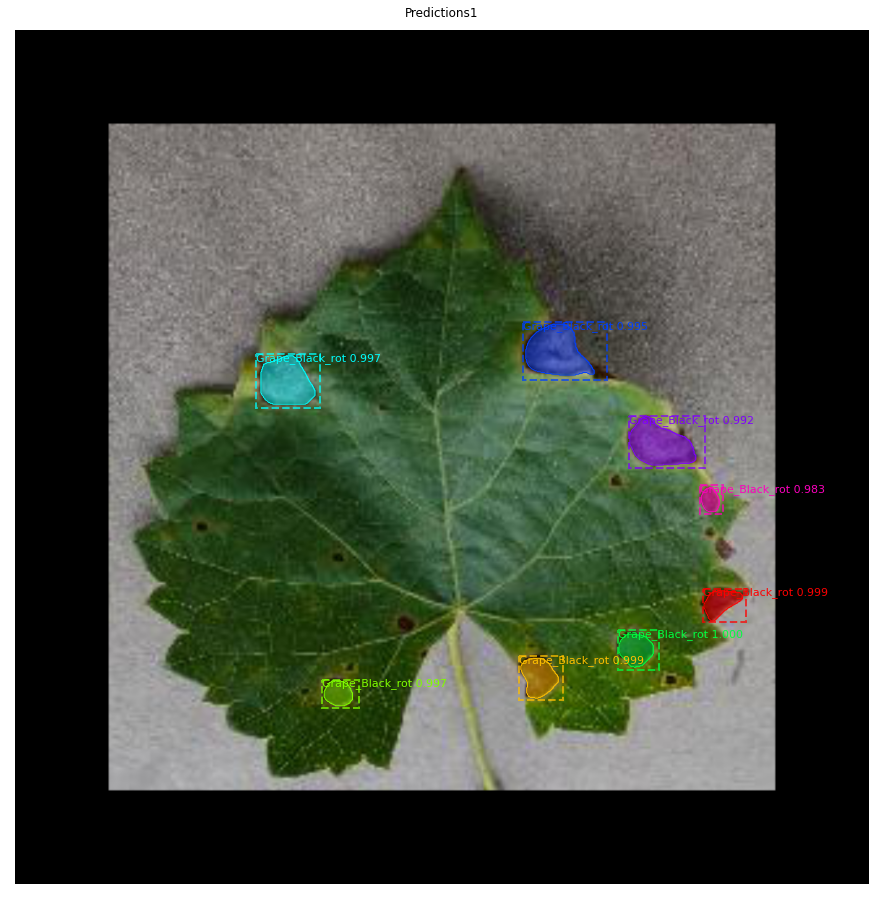

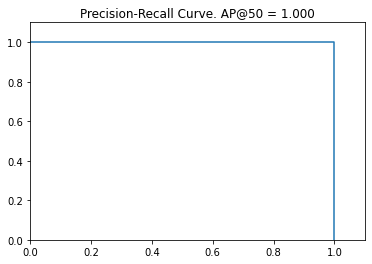

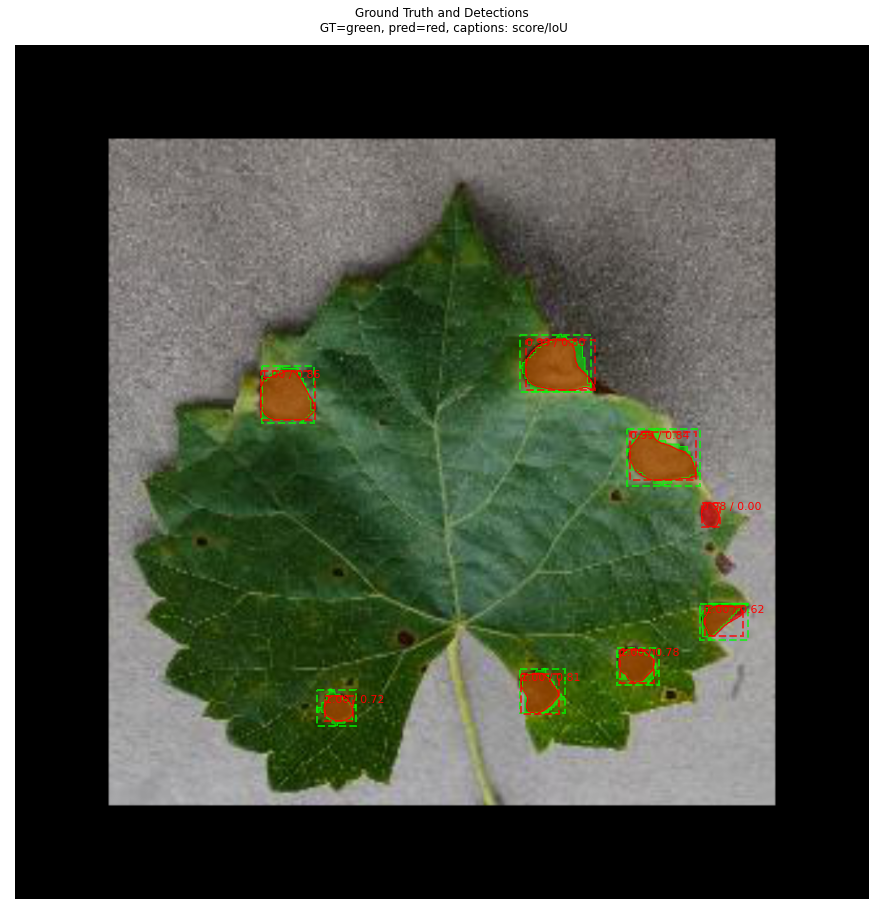

image id is : 42
image ID: object.Grape_Black_rot (517).JPG (42) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (517).JPG
gt_class_id [2 2 2 2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  233.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  129.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 5.4905624


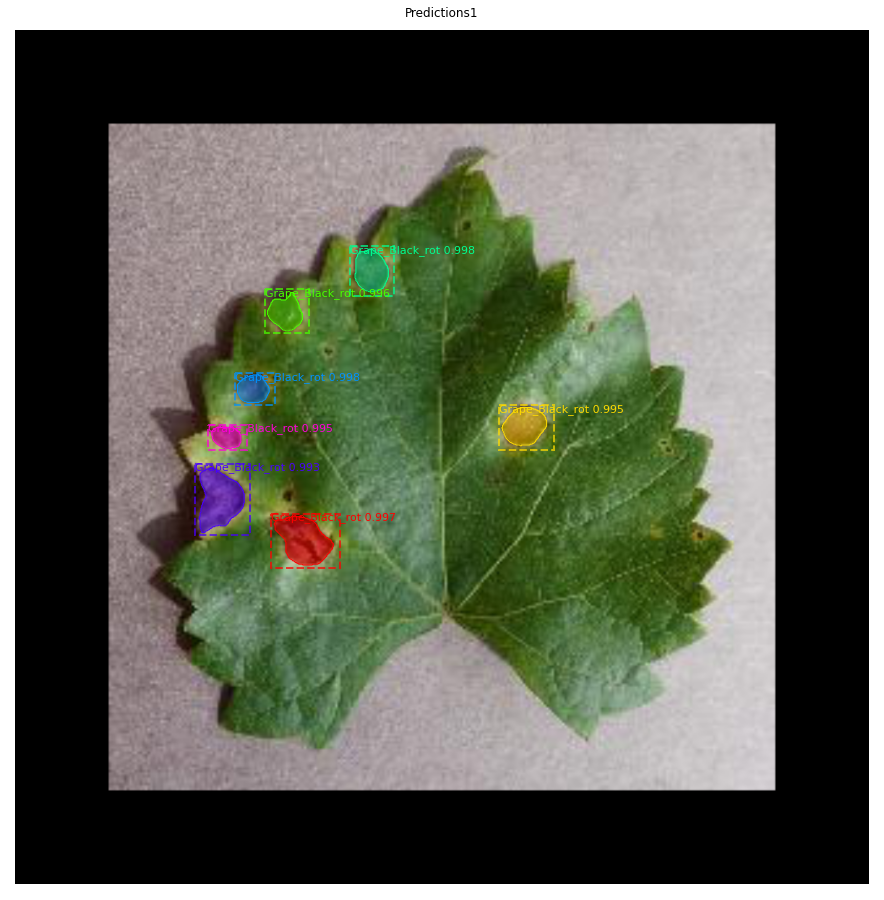

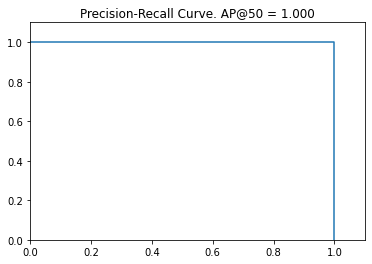

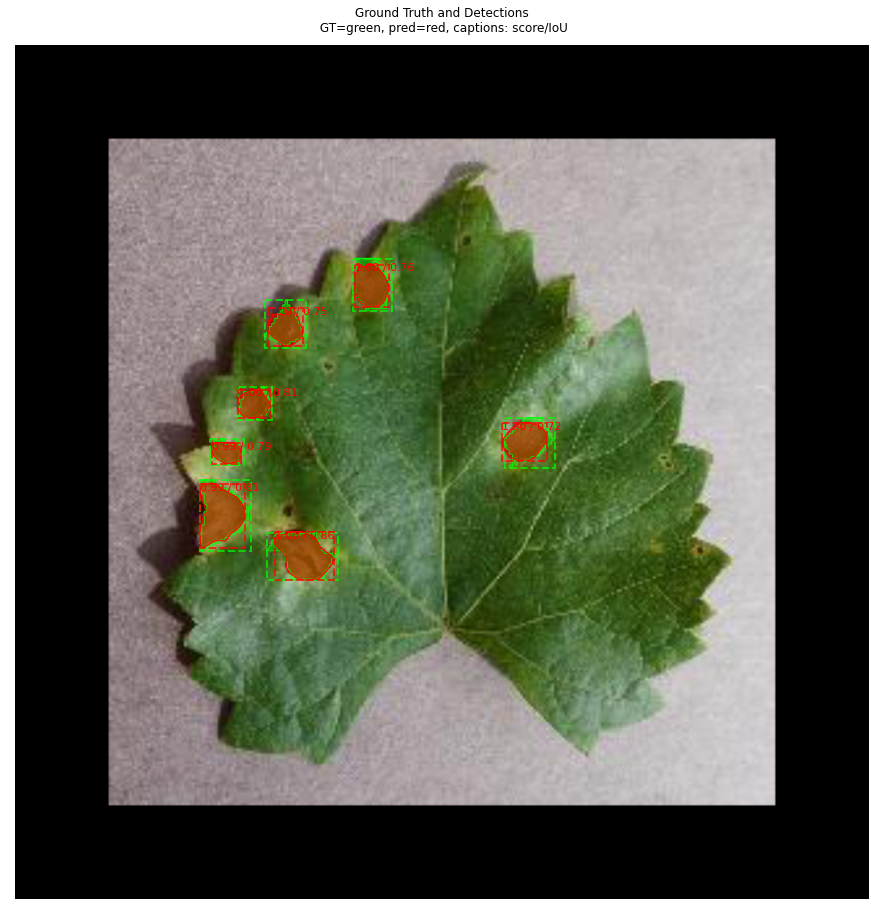

image id is : 43
image ID: object.Grape_Black_rot (521).JPG (43) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (521).JPG
gt_class_id [2 2 2 2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  253.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  147.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.8367347036089215
iou dimensions 4.20468


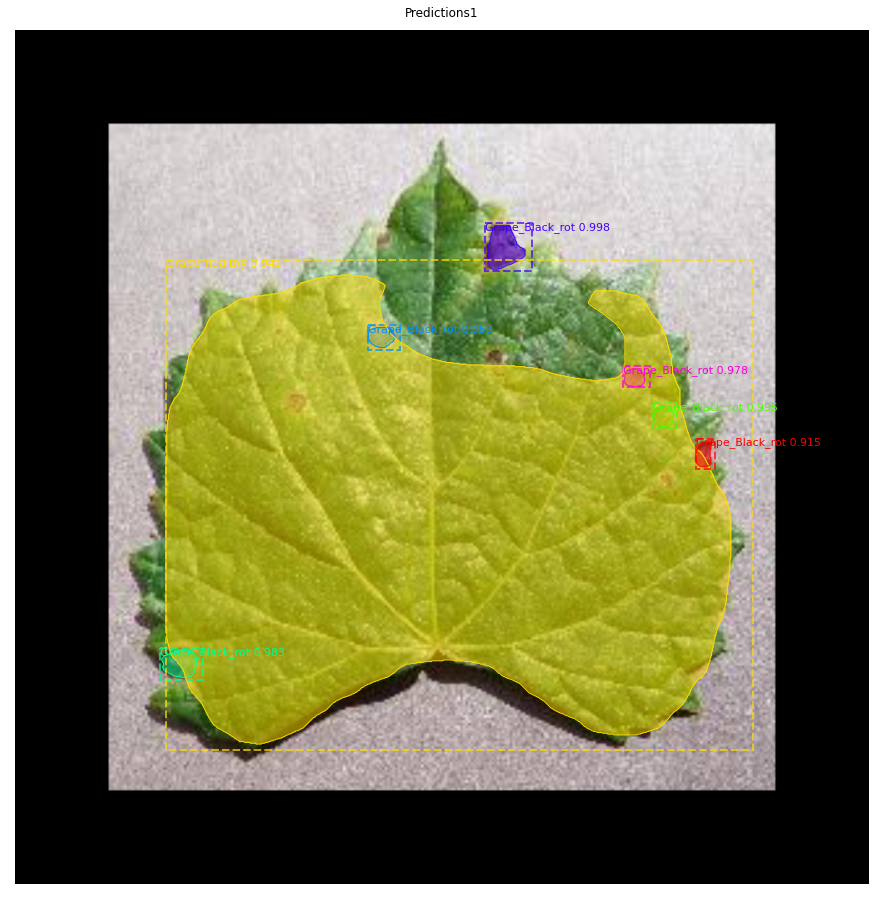

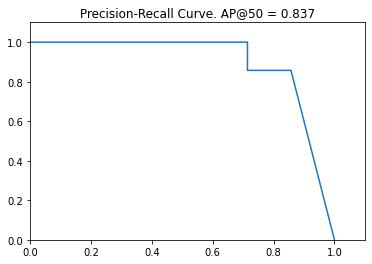

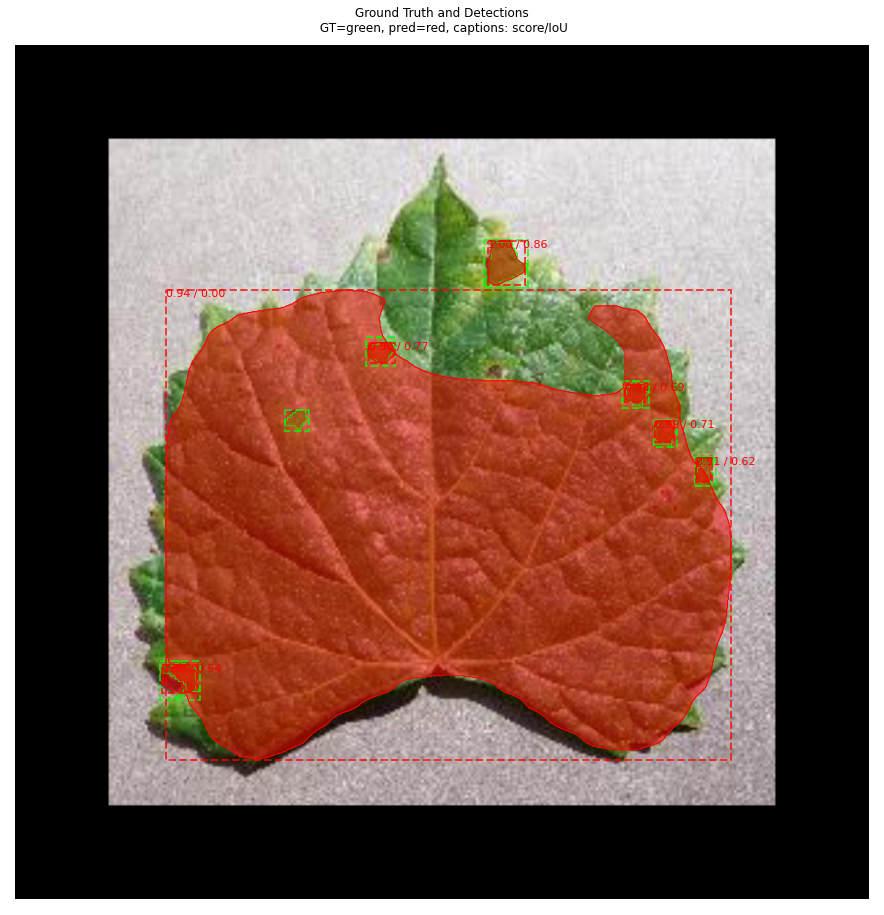

image id is : 44
image ID: object.Grape_Black_rot (527).JPG (44) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (527).JPG
gt_class_id [2 2 2 2 2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  193.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   88.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 5.860287


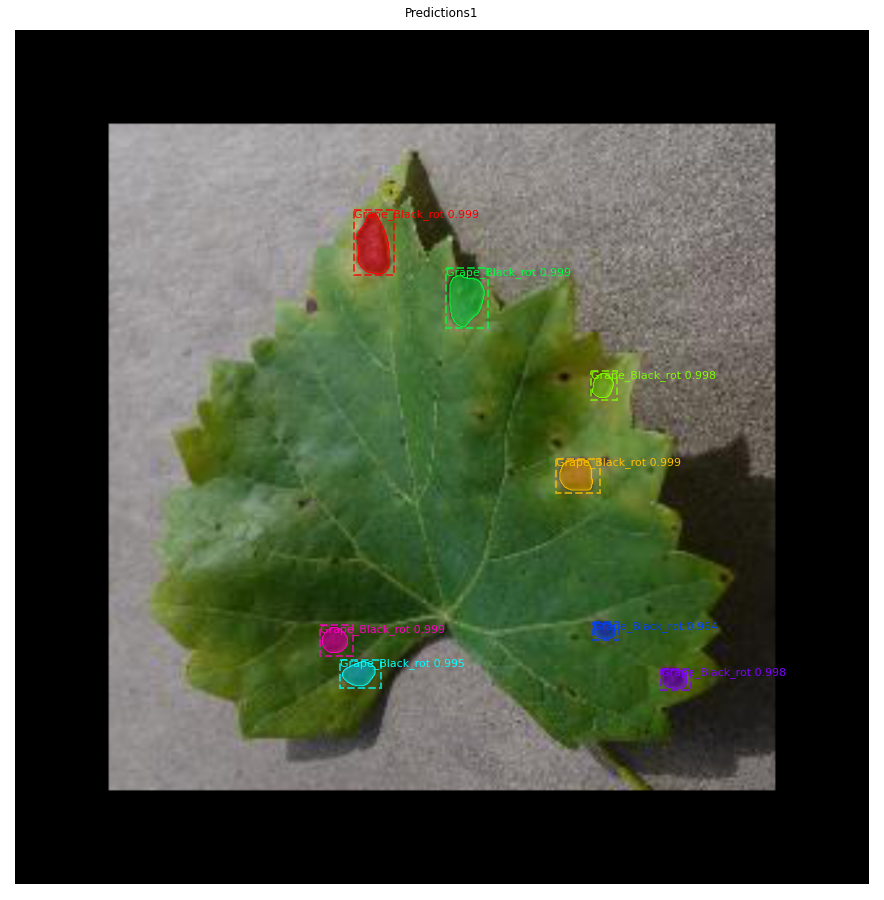

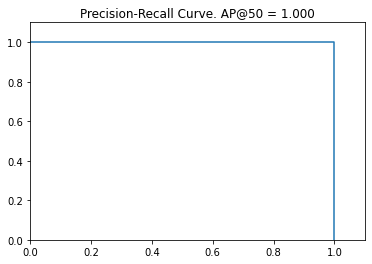

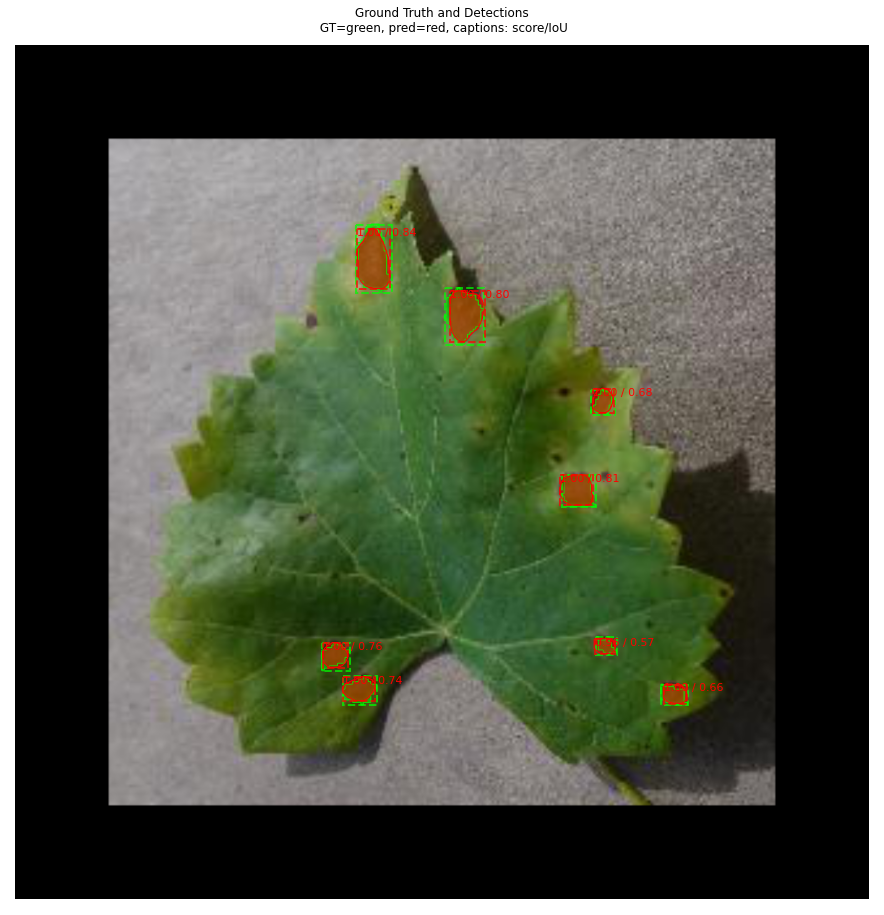

image id is : 45
image ID: object.Grape_Black_rot (528).JPG (45) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (528).JPG
gt_class_id [2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  145.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 2.218331


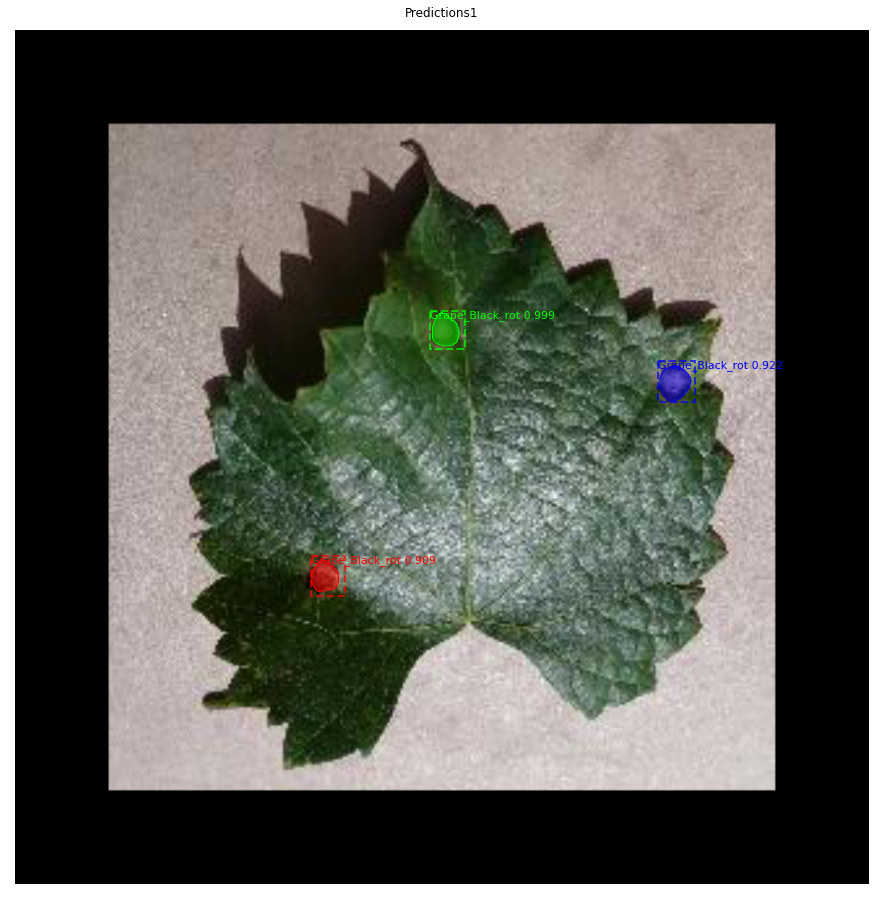

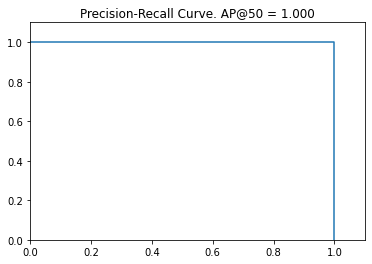

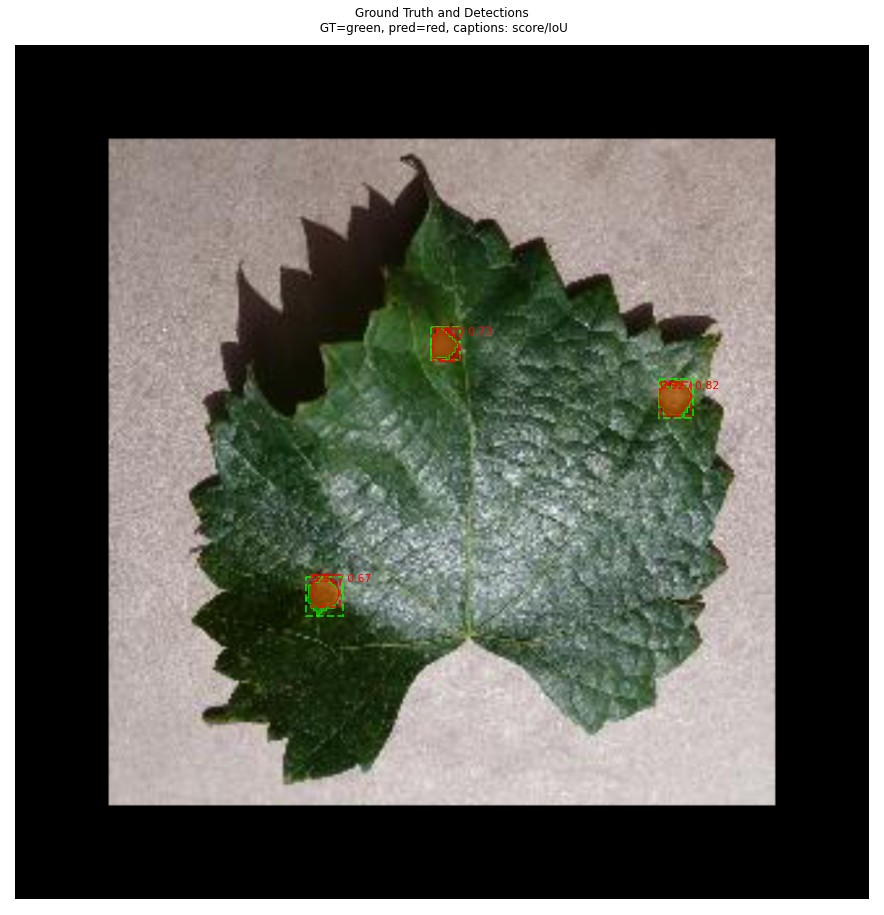

image id is : 46
image ID: object.Grape_Black_rot (532).JPG (46) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (532).JPG
gt_class_id [2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  208.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   84.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 3.4782572


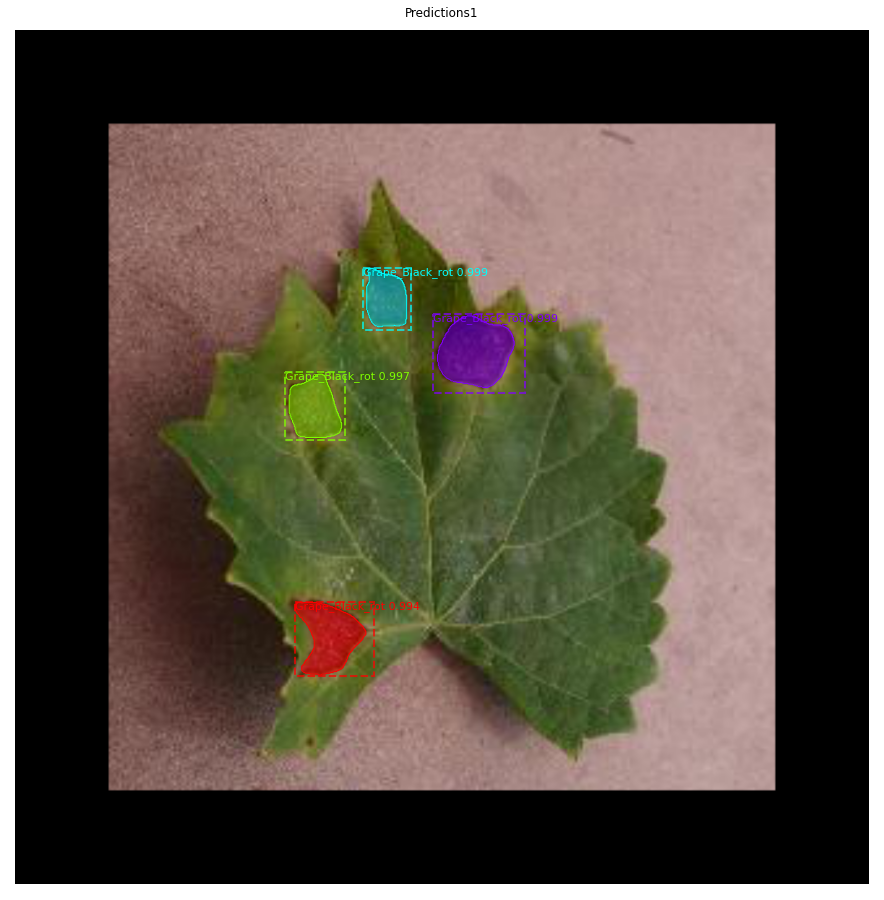

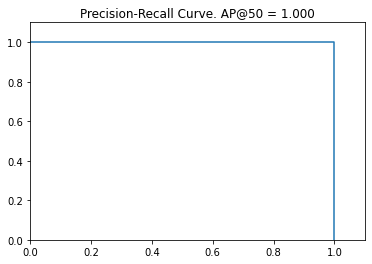

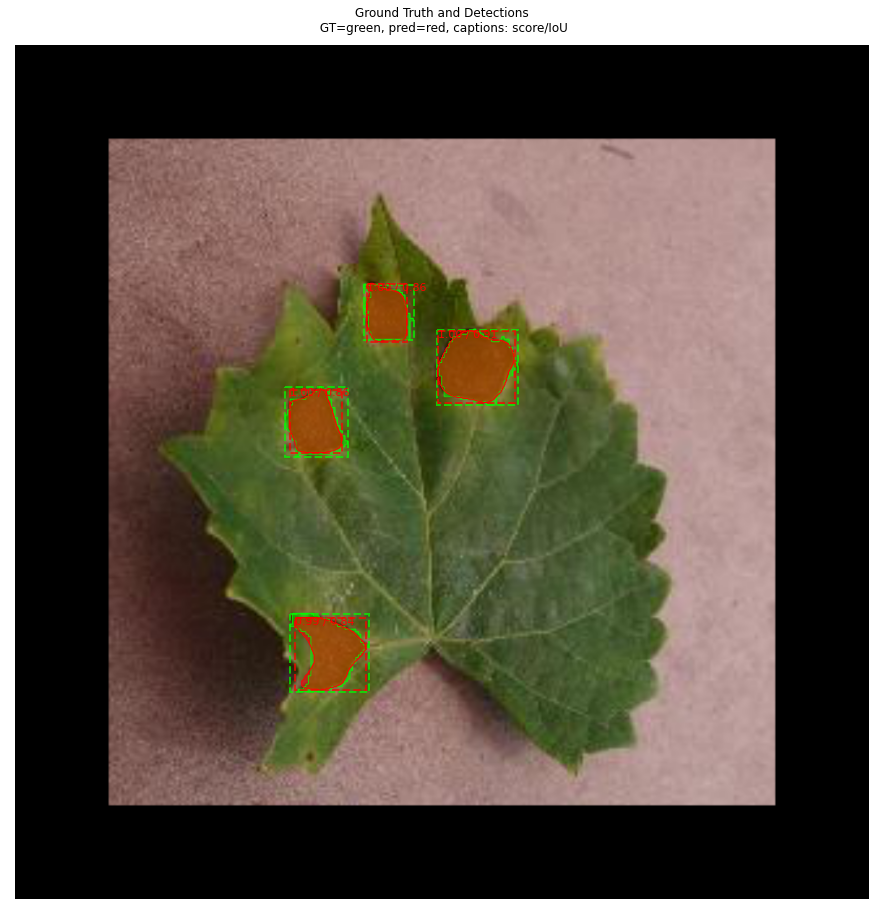

image id is : 47
image ID: object.Grape_Black_rot (535).JPG (47) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (535).JPG
gt_class_id [2 2 2 2 2 2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  236.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  119.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.8888888955116272
iou dimensions 6.425577


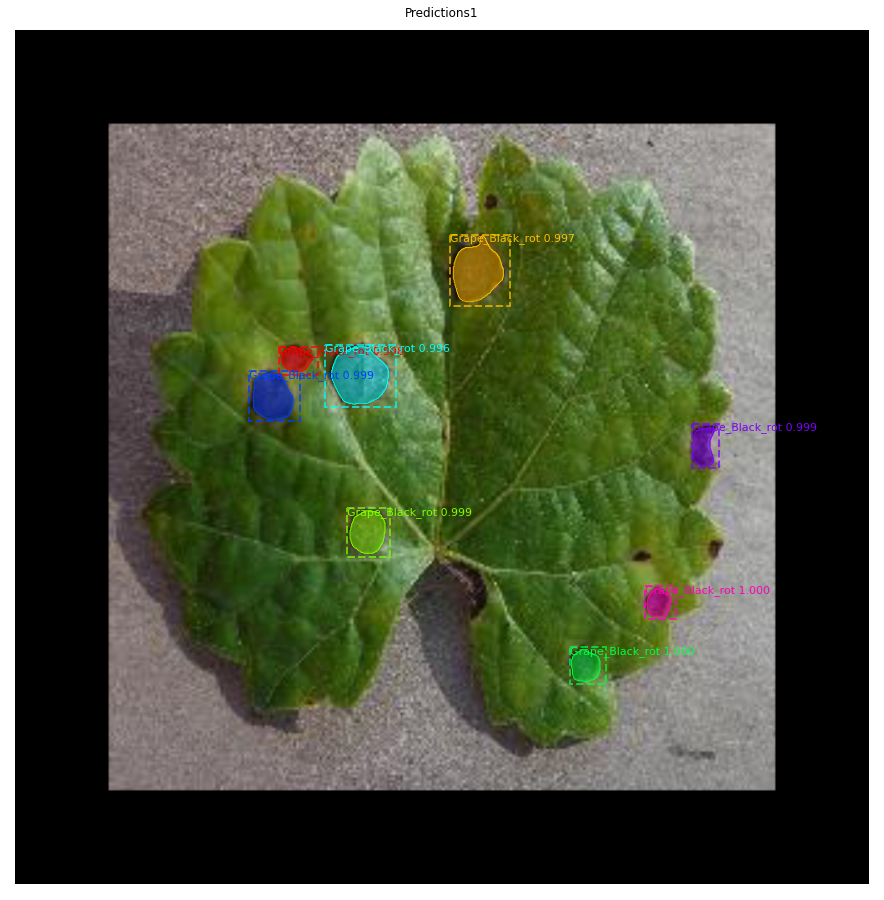

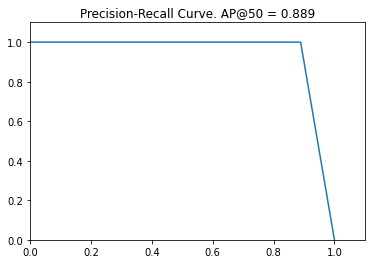

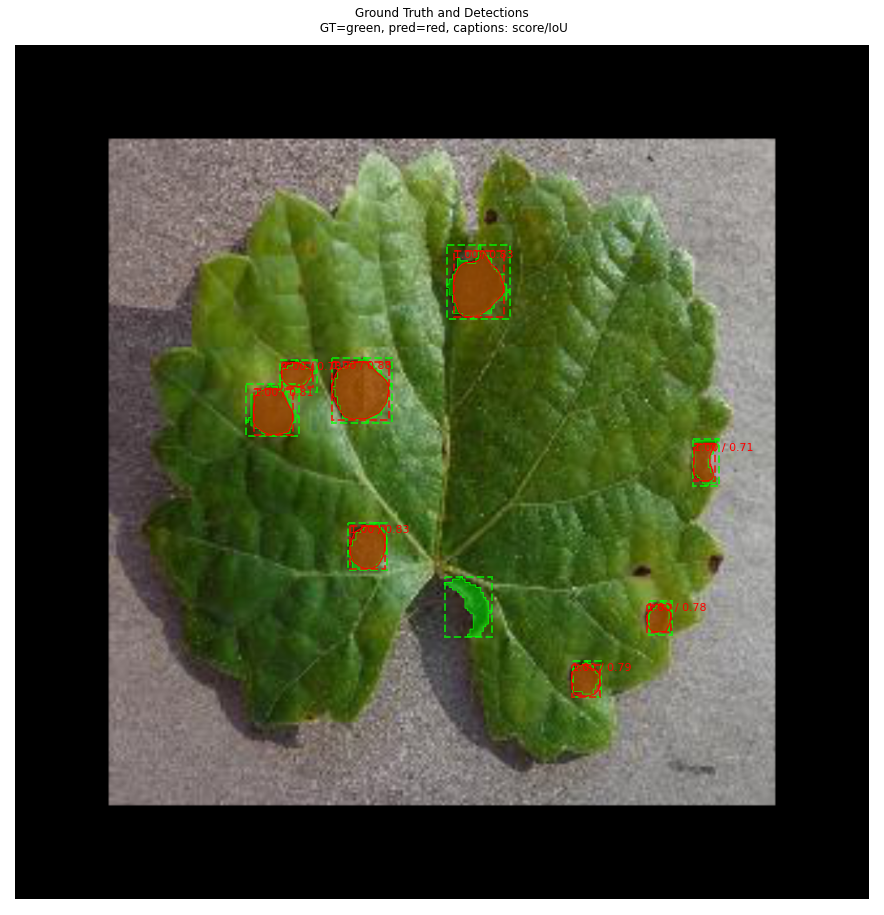

image id is : 48
image ID: object.Grape_Black_rot (574).JPG (48) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (574).JPG
gt_class_id [2 2 2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  251.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  144.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.800000011920929
iou dimensions 3.10871


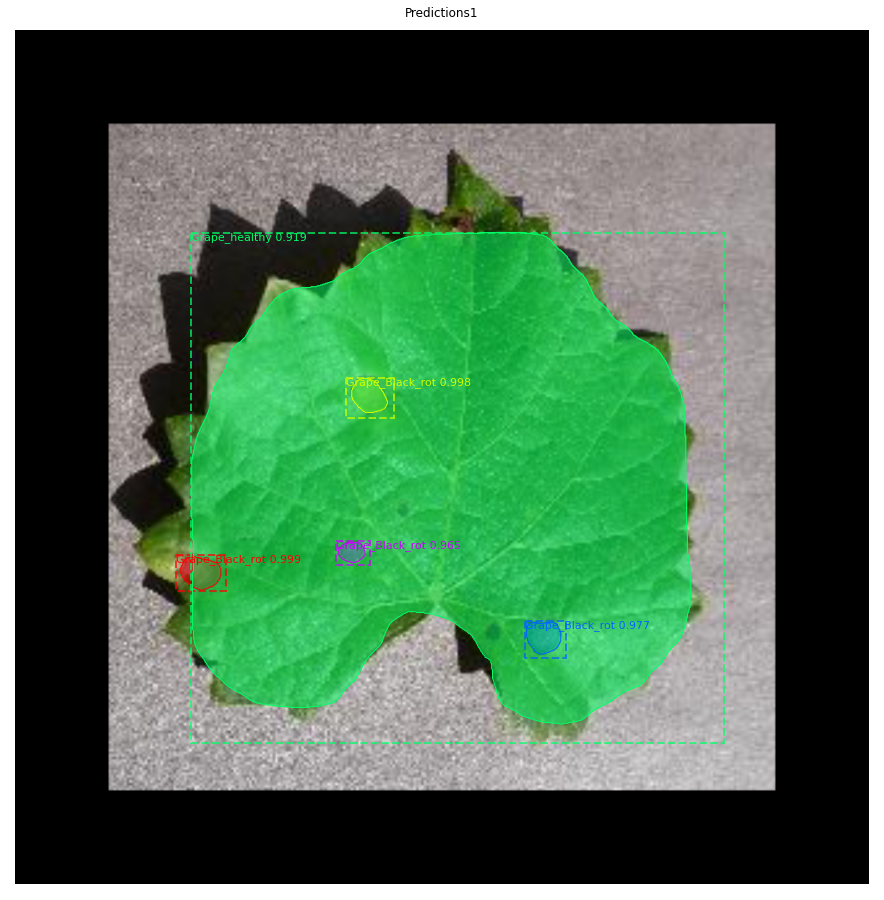

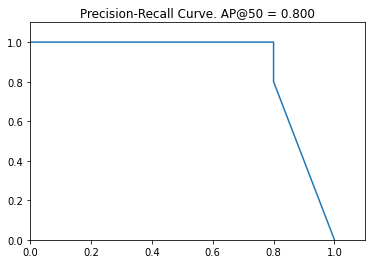

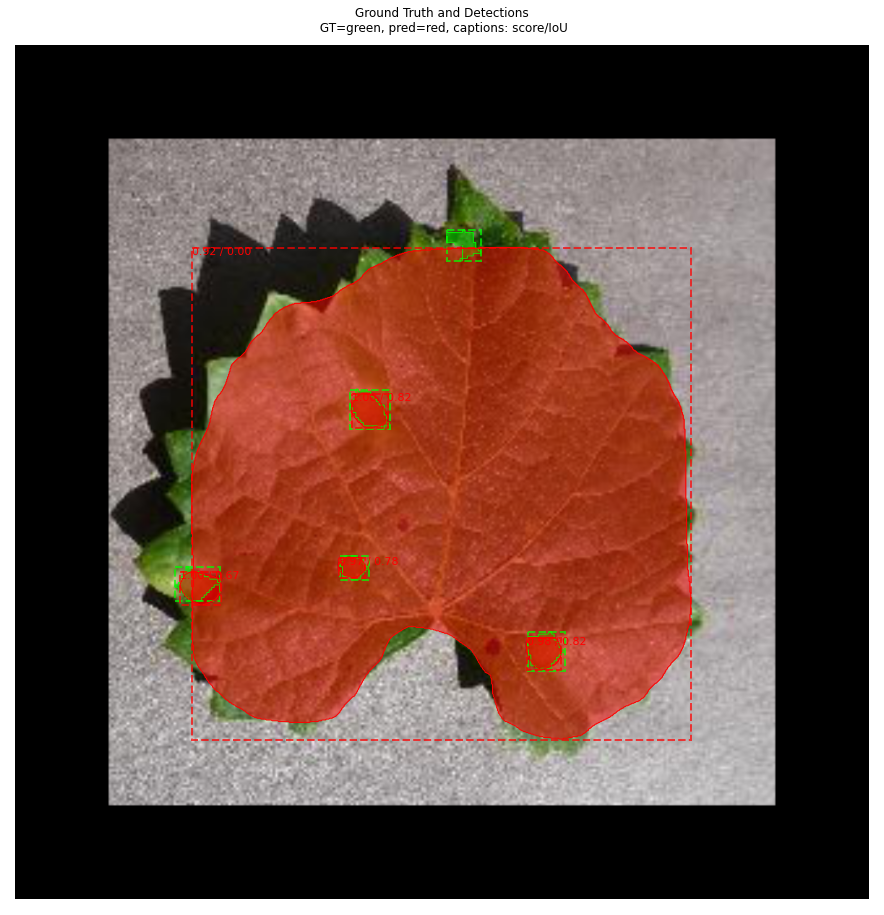

image id is : 49
image ID: object.Grape_Black_rot (579).JPG (49) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (579).JPG
gt_class_id [2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  126.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 2.35893


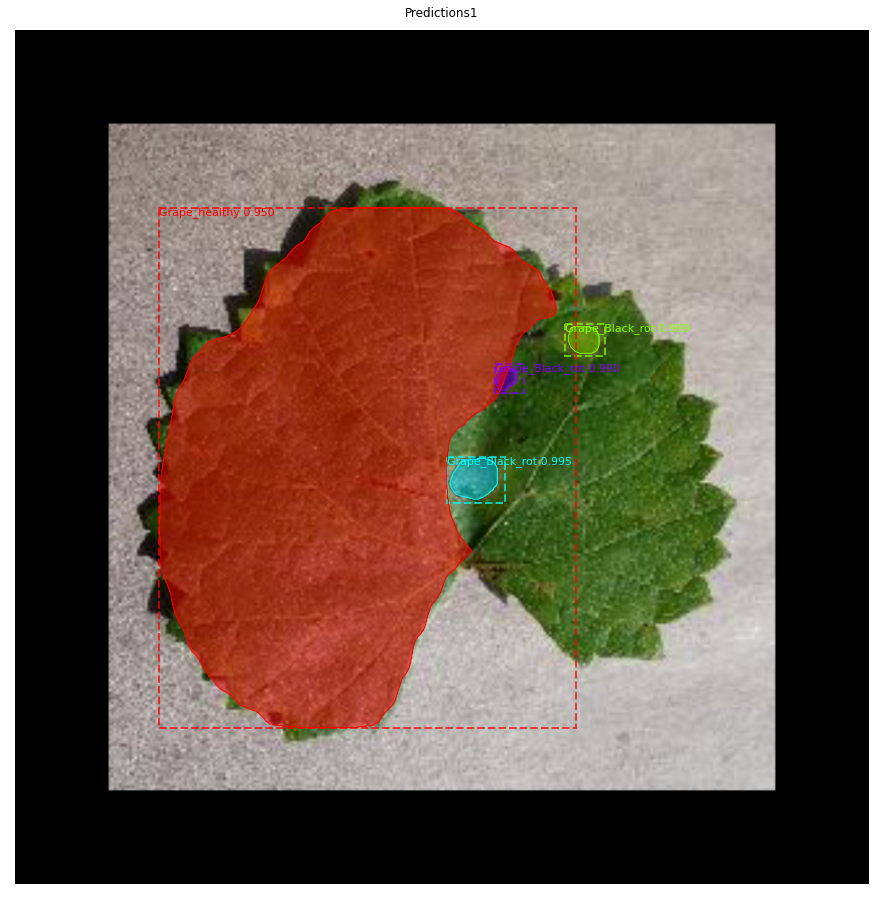

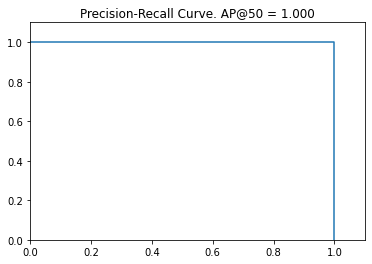

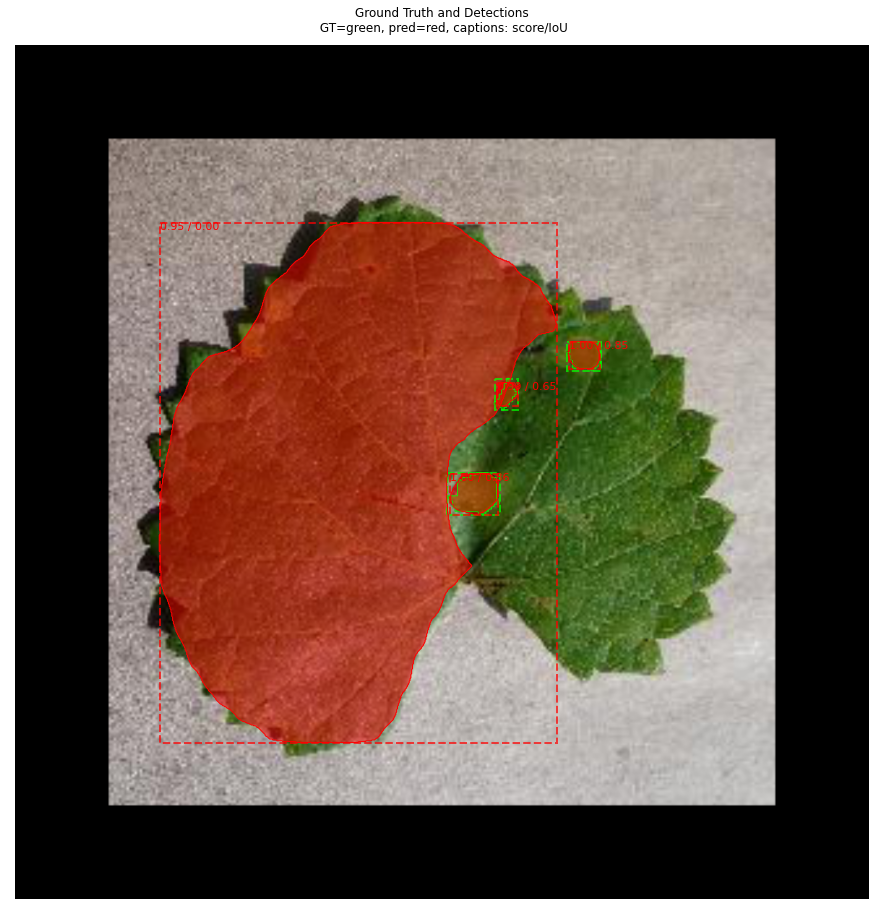

image id is : 50
image ID: object.Grape_Black_rot (589).JPG (50) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Grape_Black_rot (589).JPG
gt_class_id [2 2 2]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  247.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  134.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 2.4160492


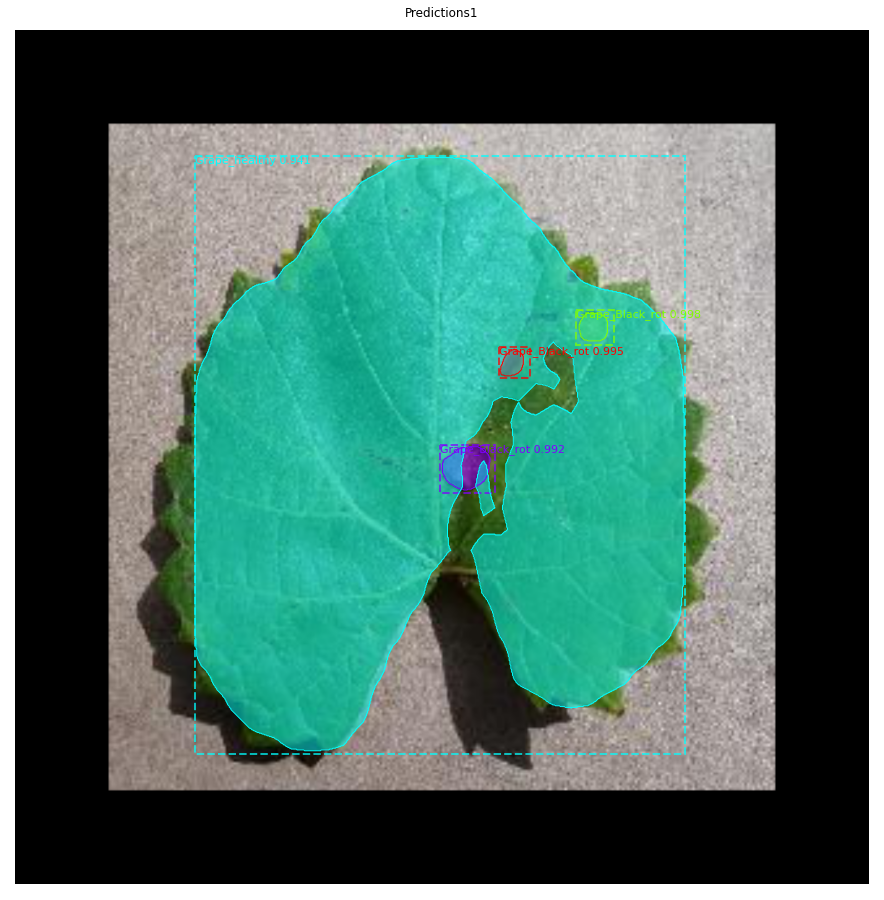

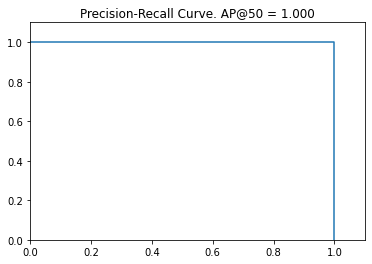

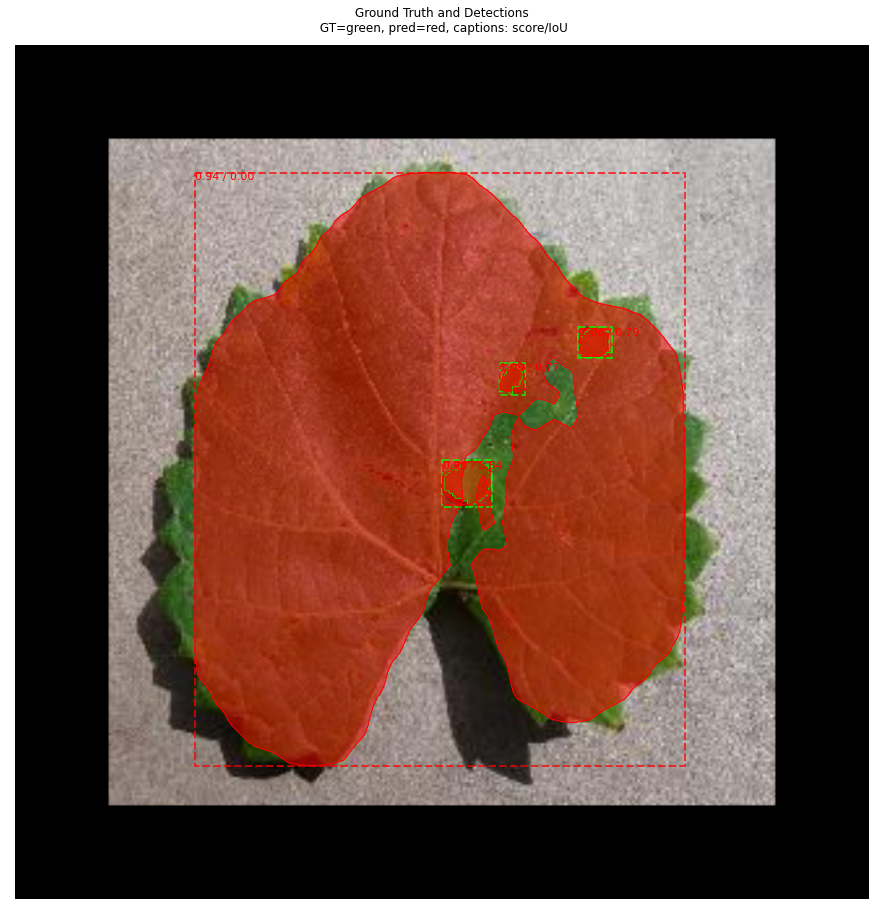

image id is : 51
image ID: object.Potato_Late_blight(57).JPG (51) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(57).JPG
gt_class_id [6 6 6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  202.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   96.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.3333333432674408
iou dimensions 0.83445513


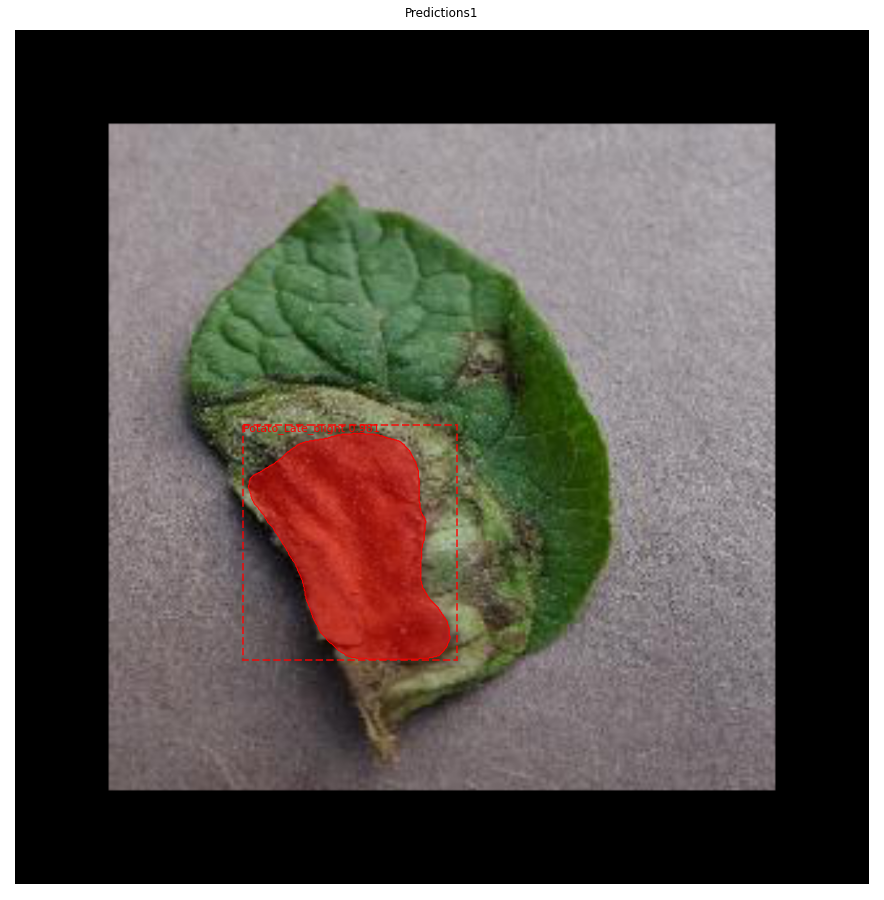

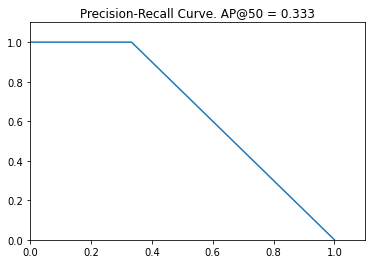

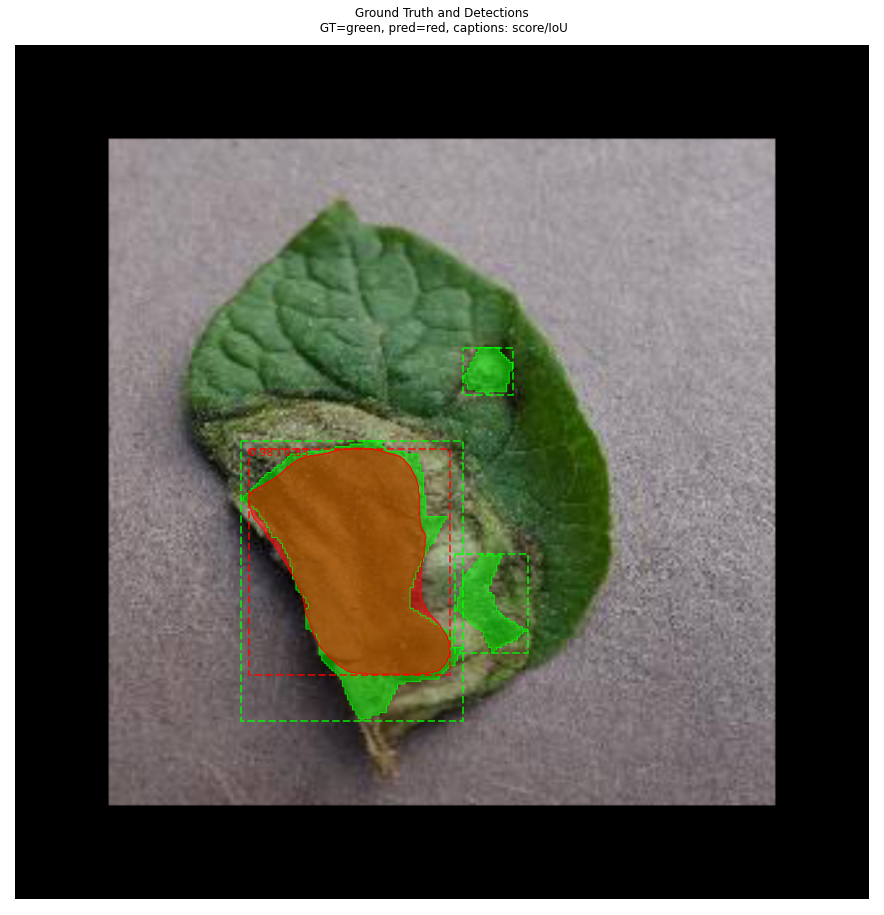

image id is : 52
image ID: object.Potato_Late_blight(58).JPG (52) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(58).JPG
gt_class_id [6 6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  242.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  125.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.5
iou dimensions 1.181638


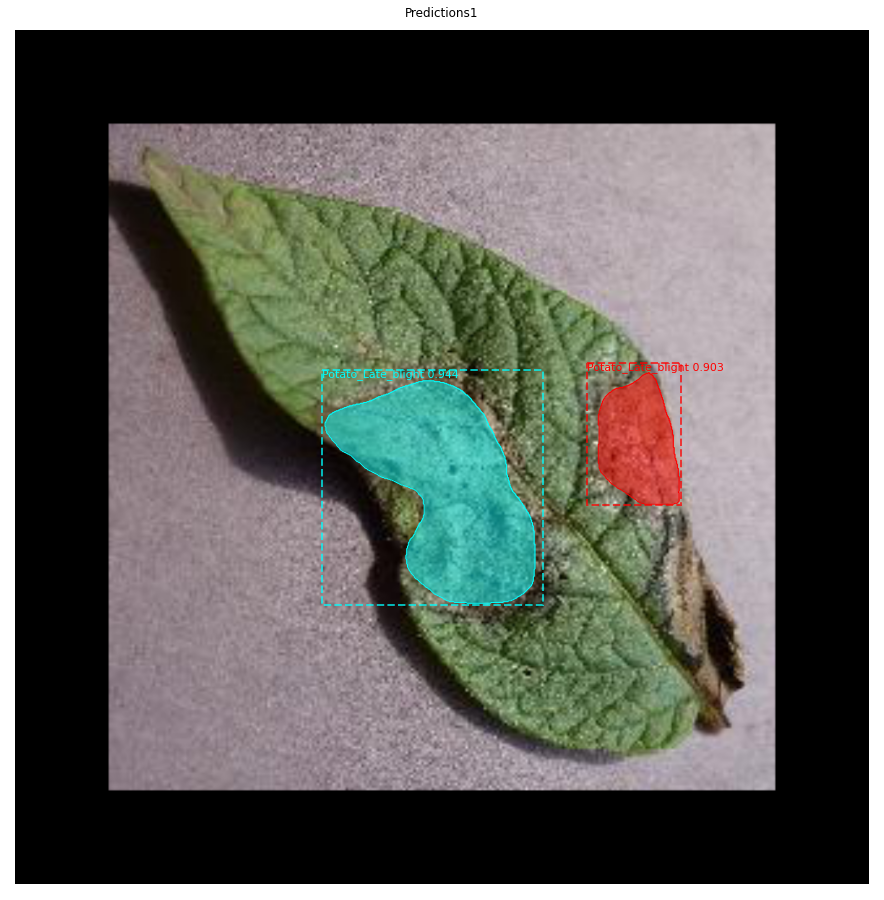

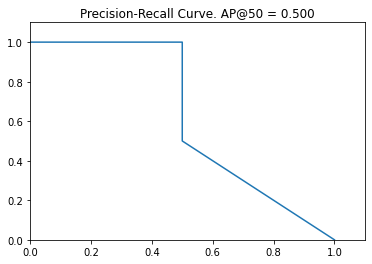

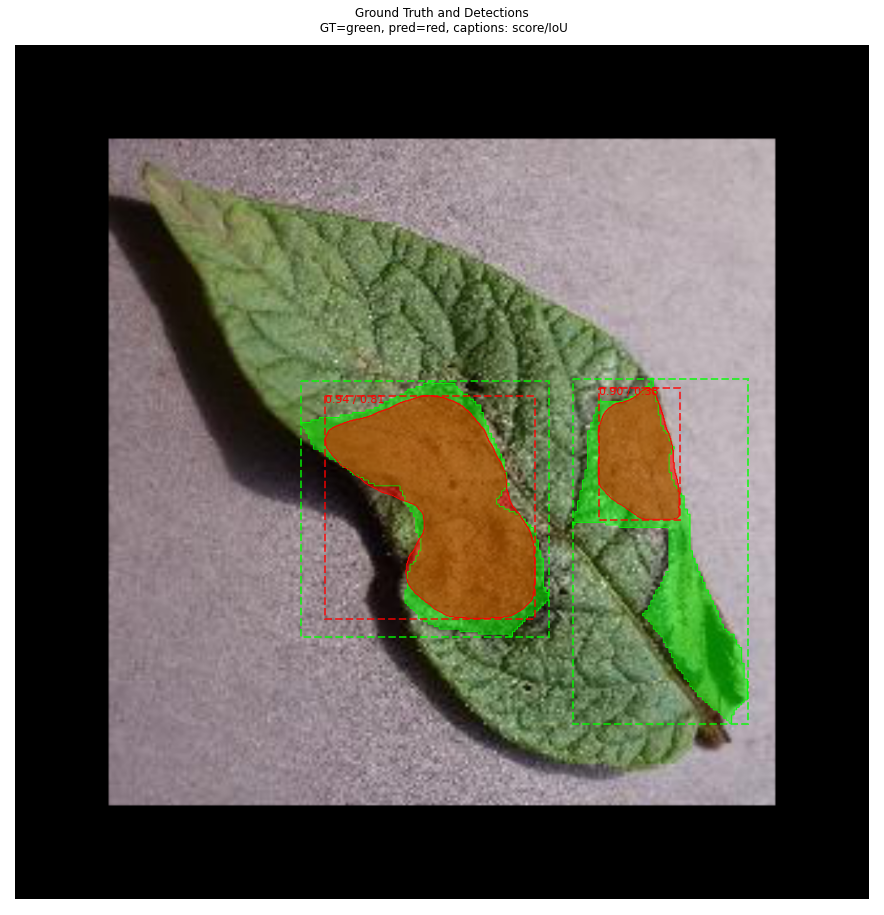

image id is : 53
image ID: object.Potato_Late_blight(71).JPG (53) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(71).JPG
gt_class_id [6 6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  249.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  135.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.0
iou dimensions 0.57788527


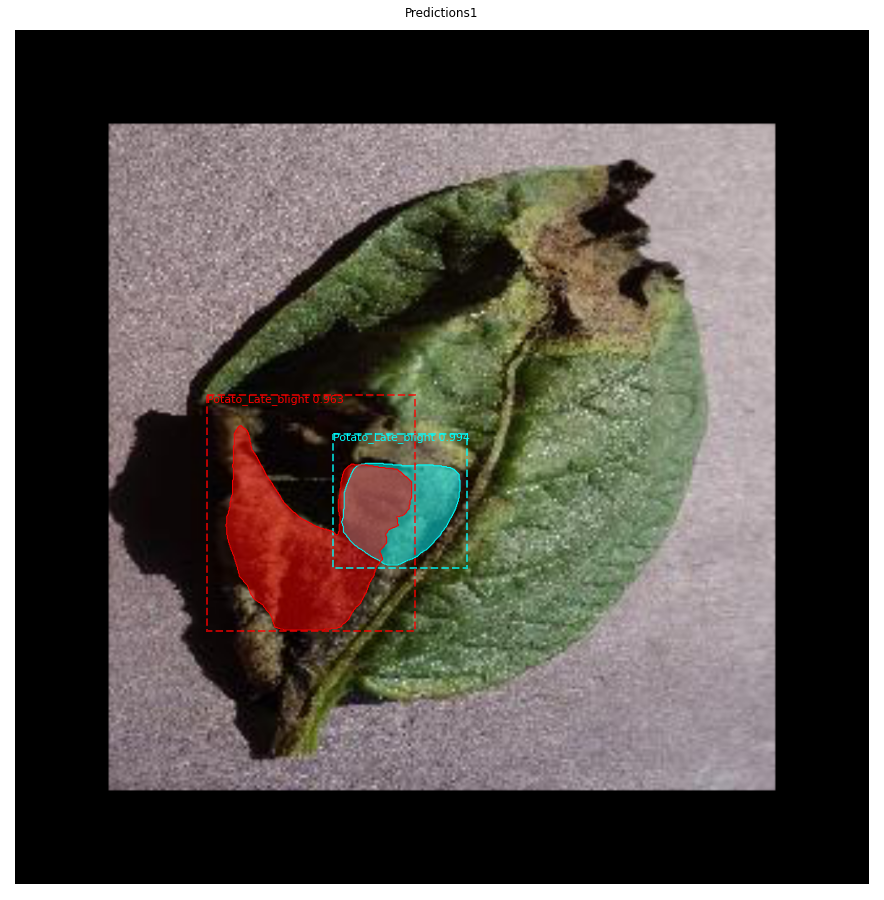

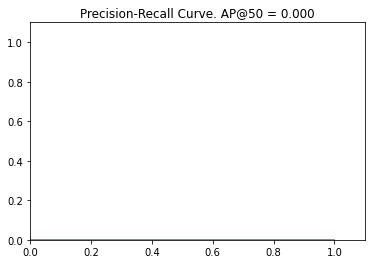

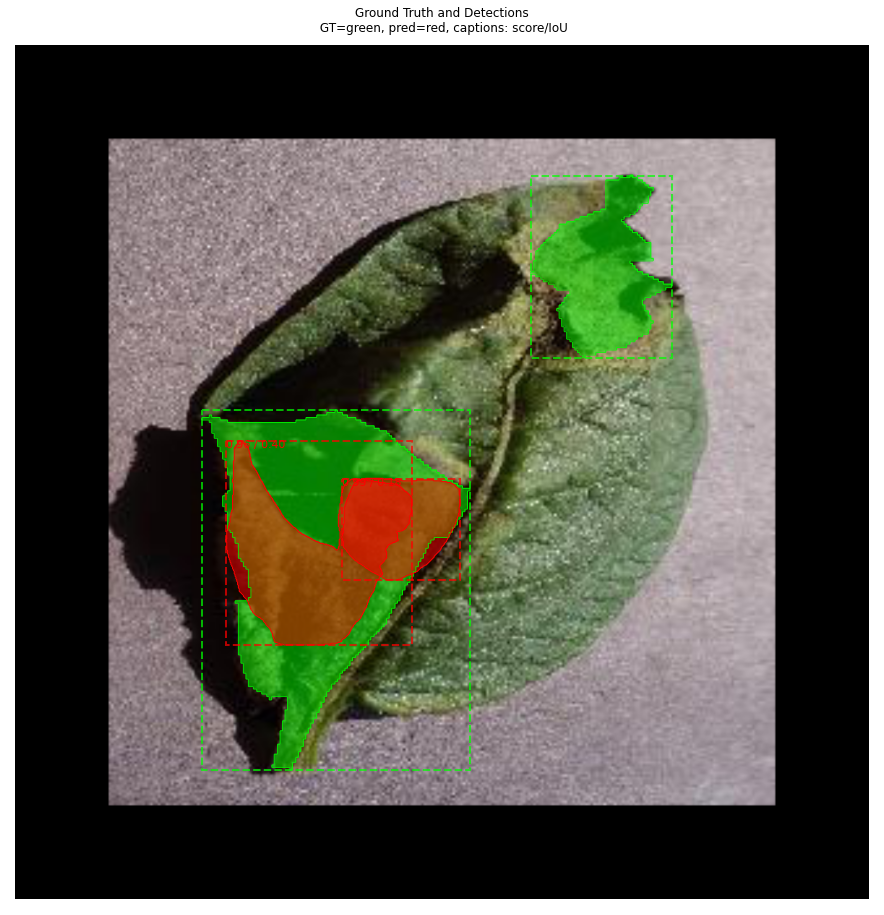

image id is : 54
image ID: object.Potato_Late_blight(83).JPG (54) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(83).JPG
gt_class_id [6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  245.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  138.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 0.55698377


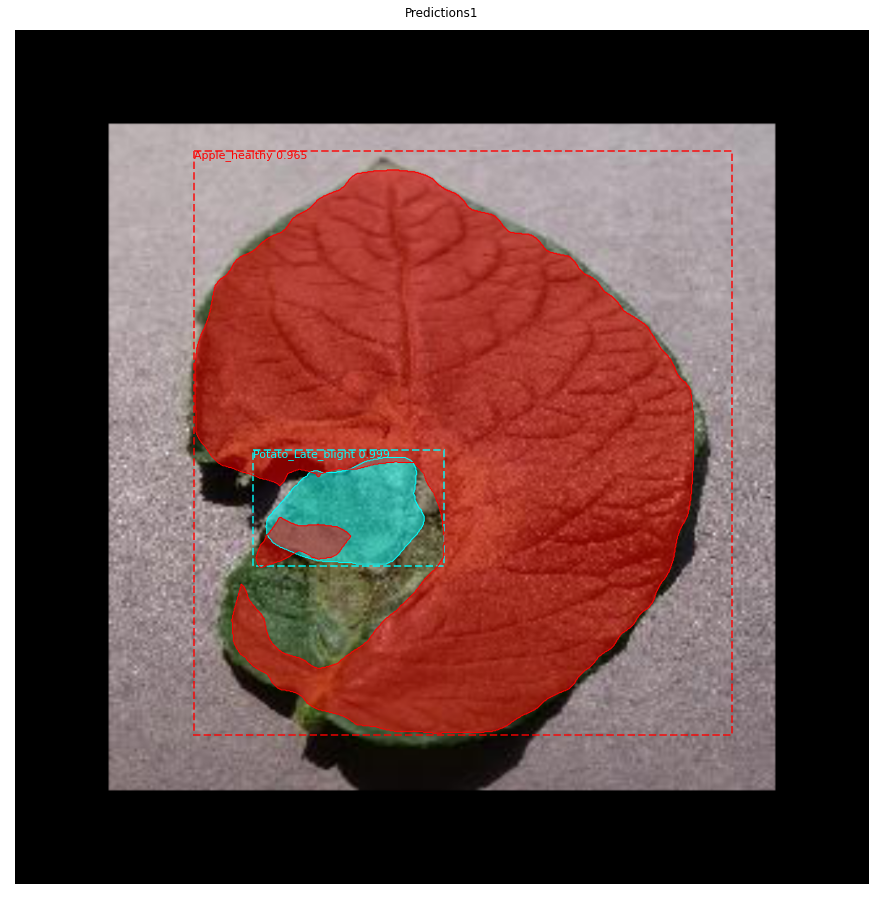

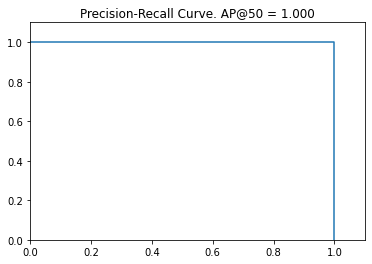

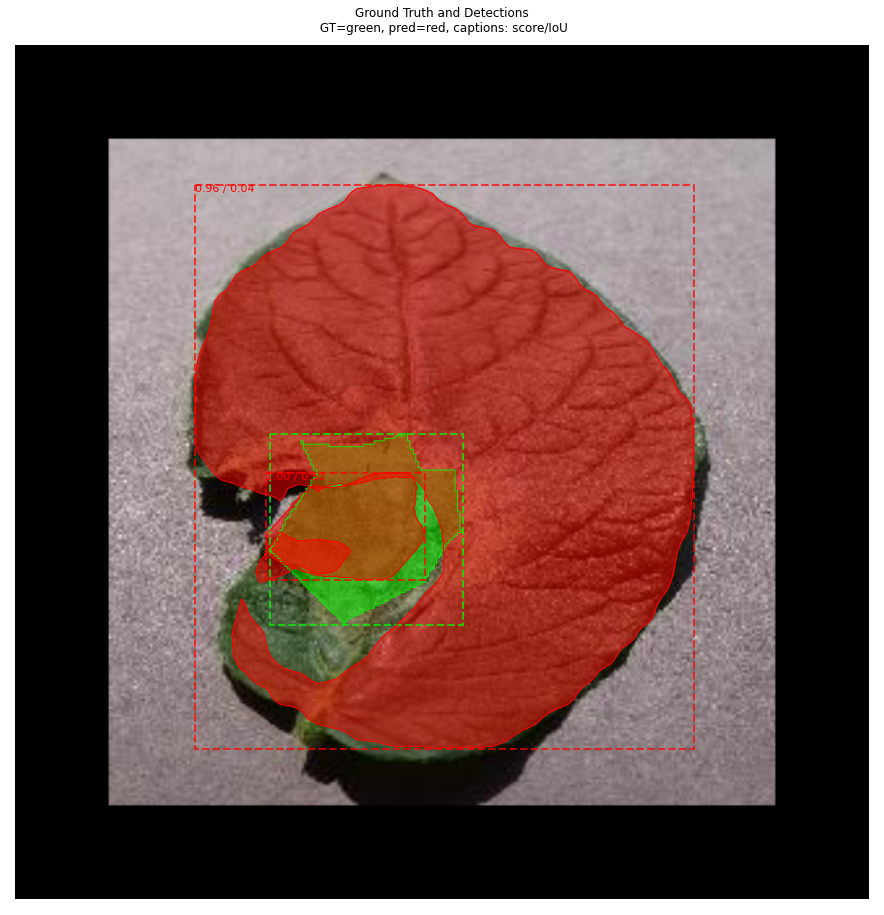

image id is : 55
image ID: object.Potato_Late_blight(91).JPG (55) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(91).JPG
gt_class_id [6 6 6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  209.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   85.30000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.6666666865348816
iou dimensions 1.3038719


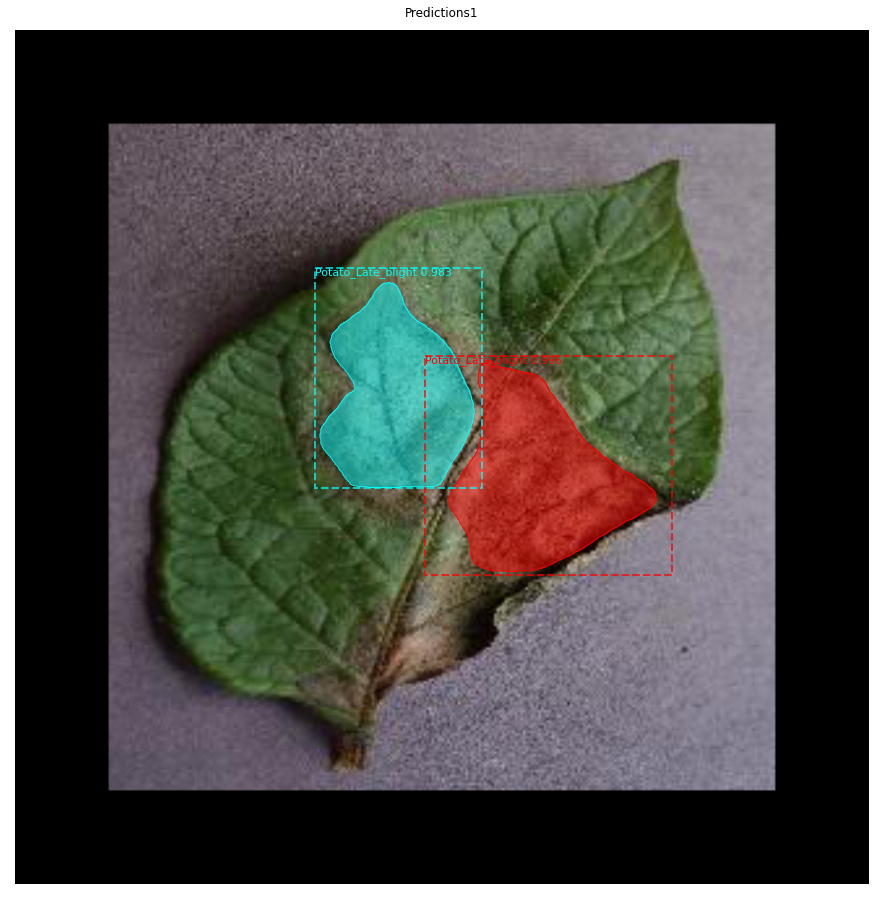

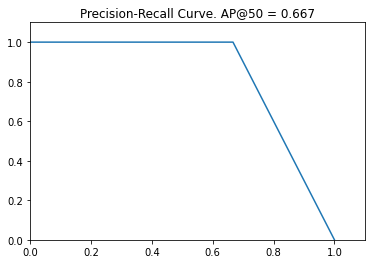

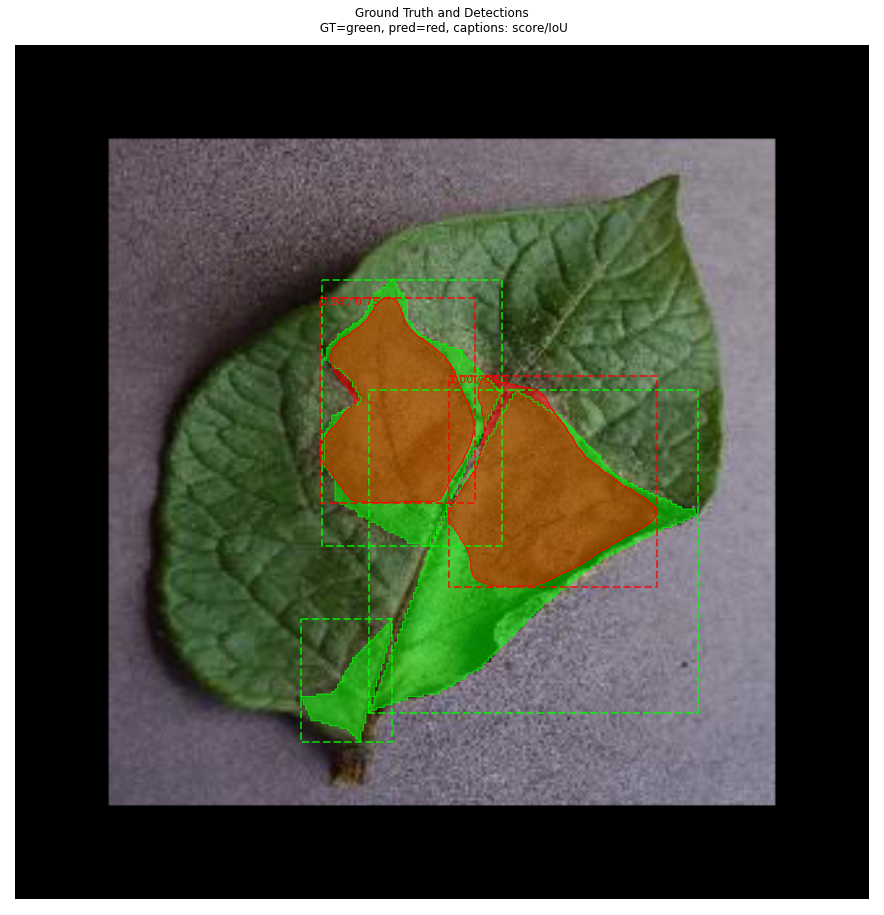

image id is : 56
image ID: object.Potato_Late_blight(111).JPG (56) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(111).JPG
gt_class_id [6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  228.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  111.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 1.0
iou dimensions 0.8431579


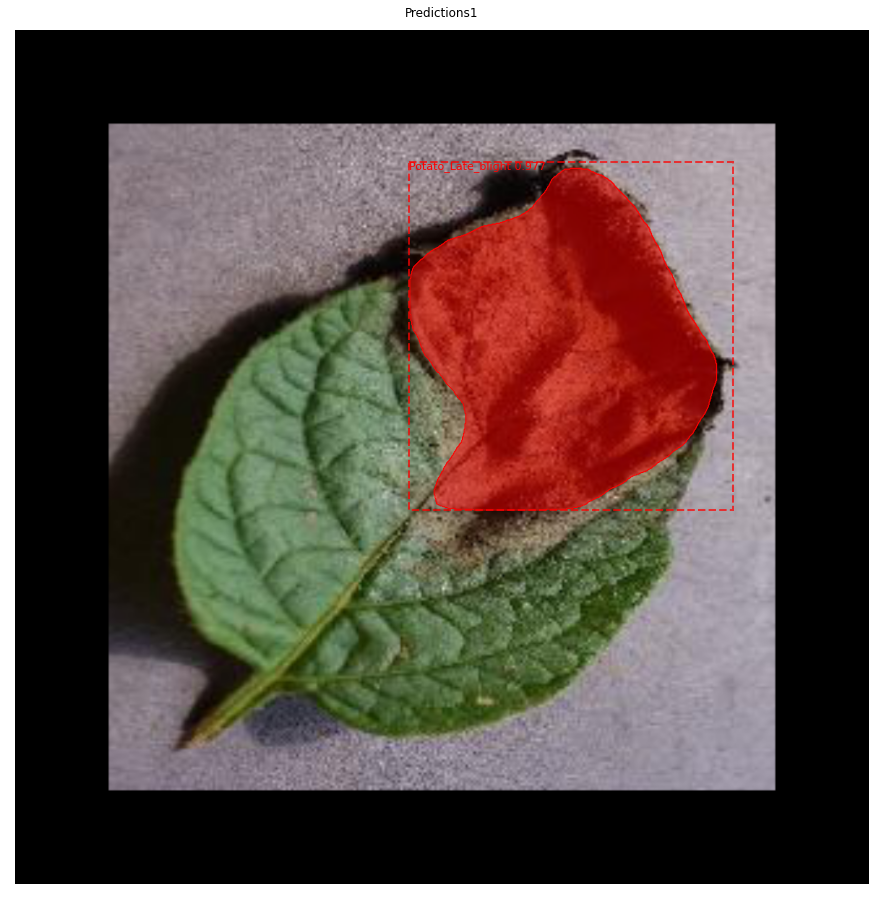

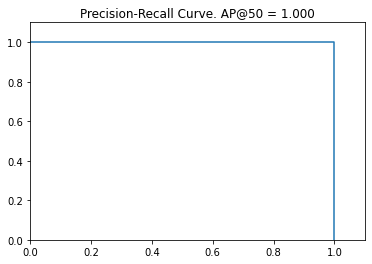

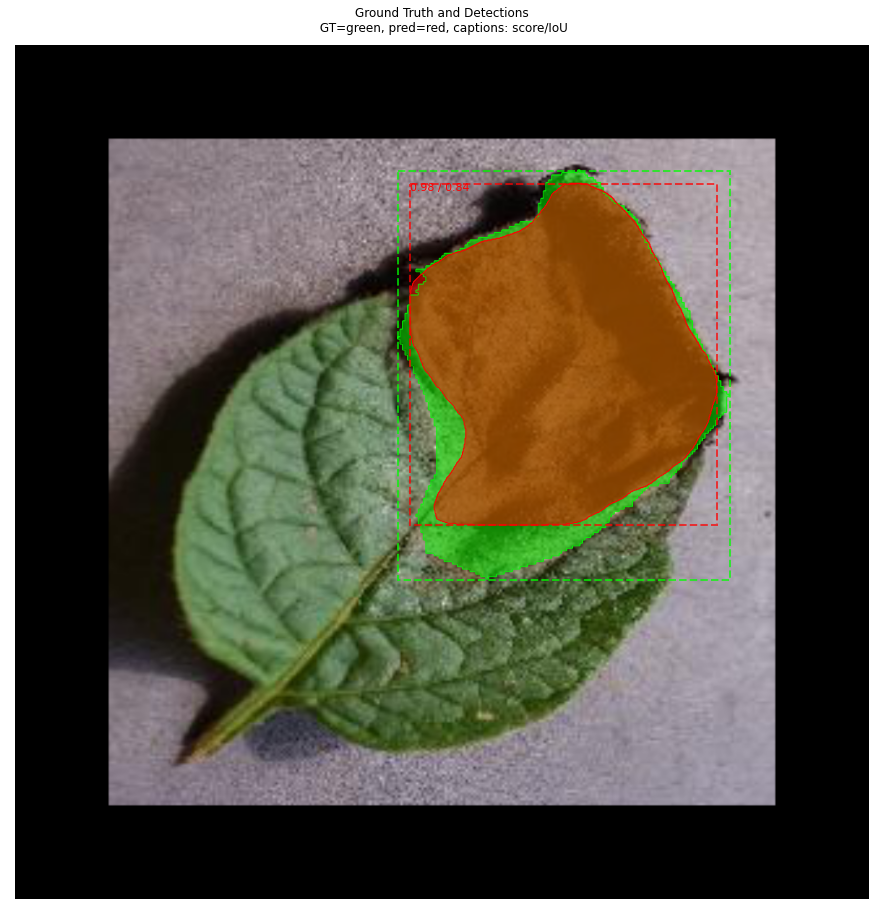

image id is : 57
image ID: object.Potato_Late_blight(120).JPG (57) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(120).JPG
gt_class_id [6 6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  199.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   82.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.5
iou dimensions 1.0217264


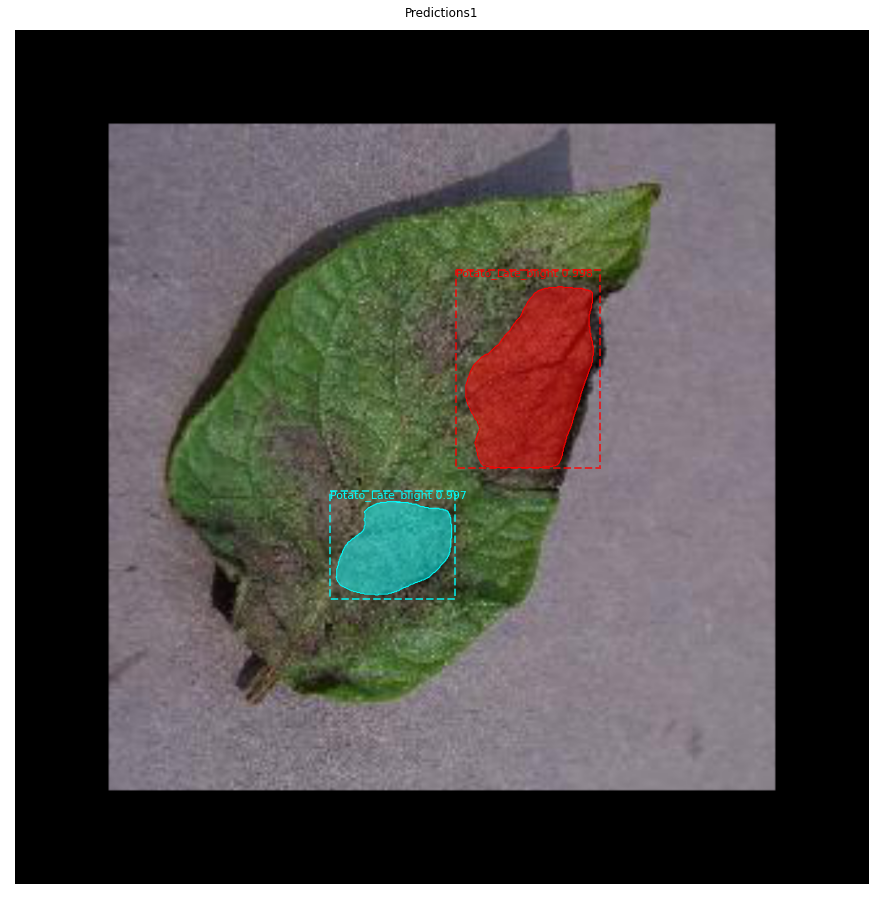

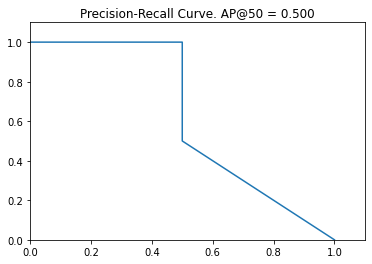

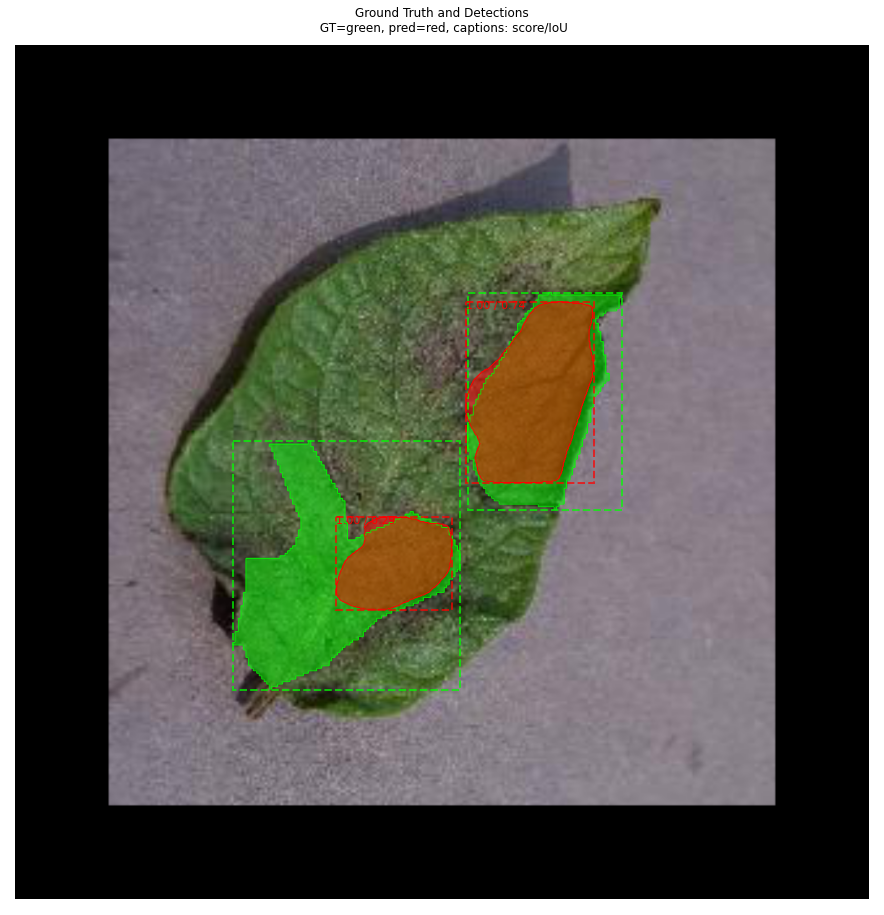

image id is : 58
image ID: object.Potato_Late_blight(158).JPG (58) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(158).JPG
gt_class_id [6 6 6 6 6 6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  237.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  120.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.3333333432674408
iou dimensions 1.3819194


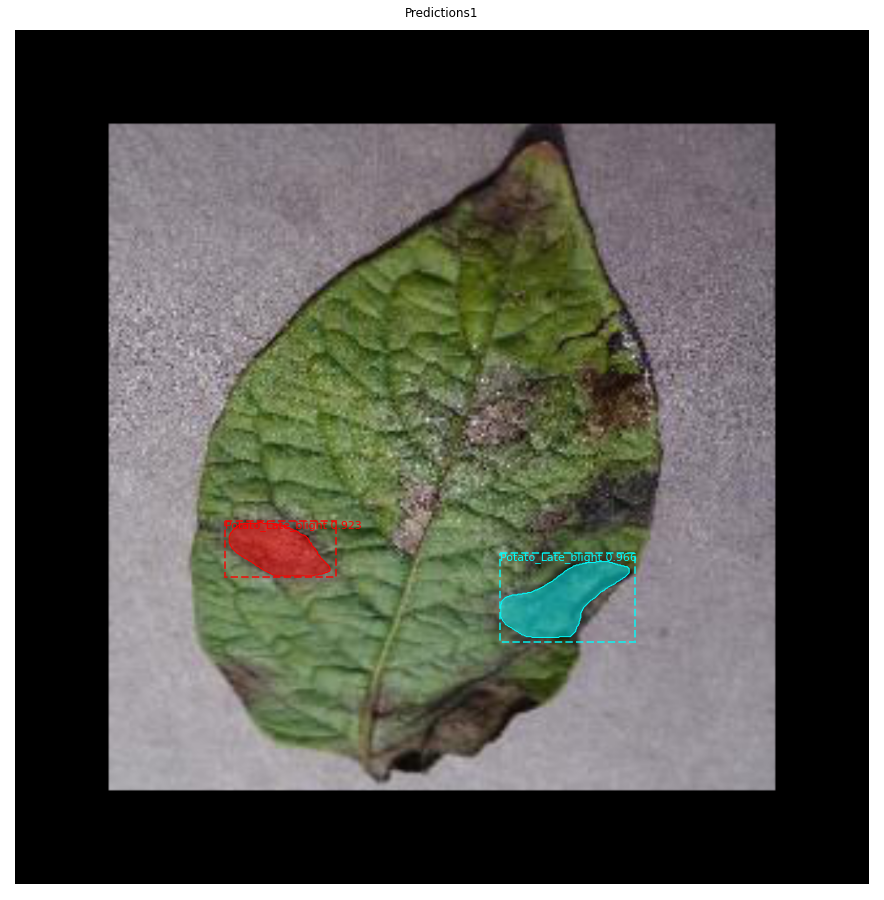

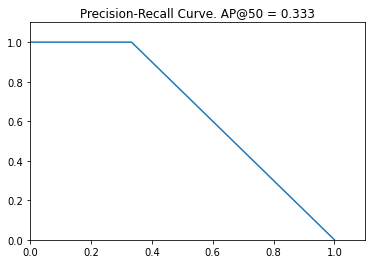

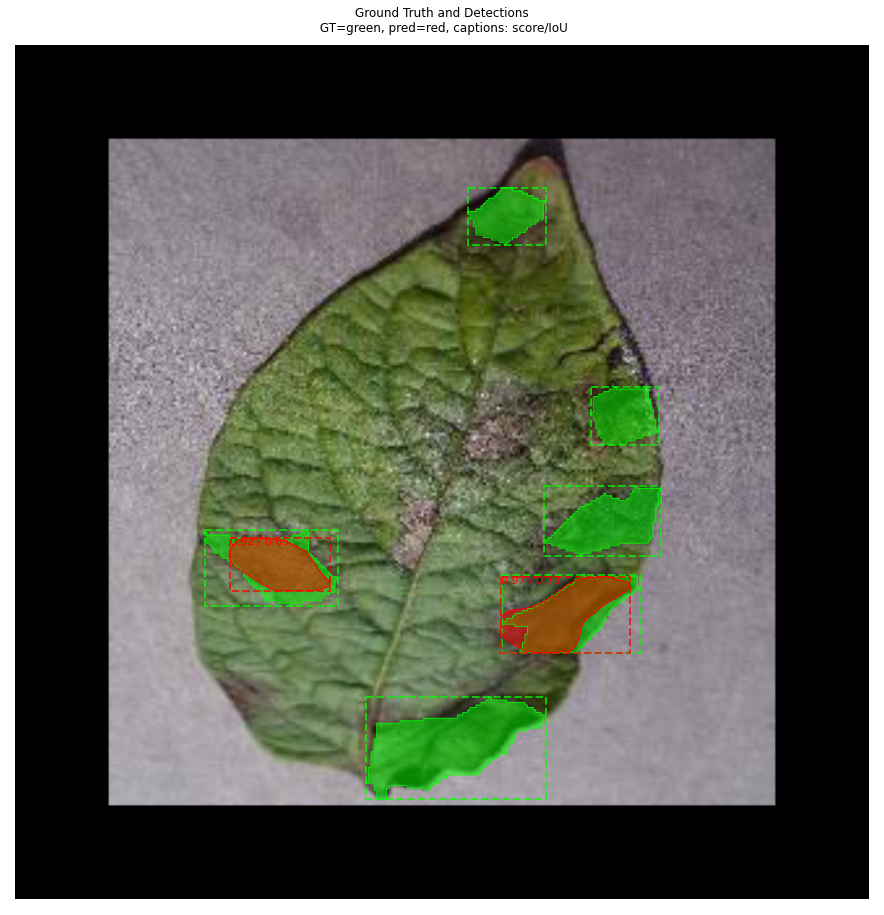

image id is : 59
image ID: object.Potato_Late_blight(159).JPG (59) /content/New folder (4)/selectedimages/test/testing_apple_black_rot/Potato_Late_blight(159).JPG
gt_class_id [6 6 6 6]
gt_class_id <class 'numpy.ndarray'>
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  250.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
AP dimensions 0.0
iou dimensions 0.29005823


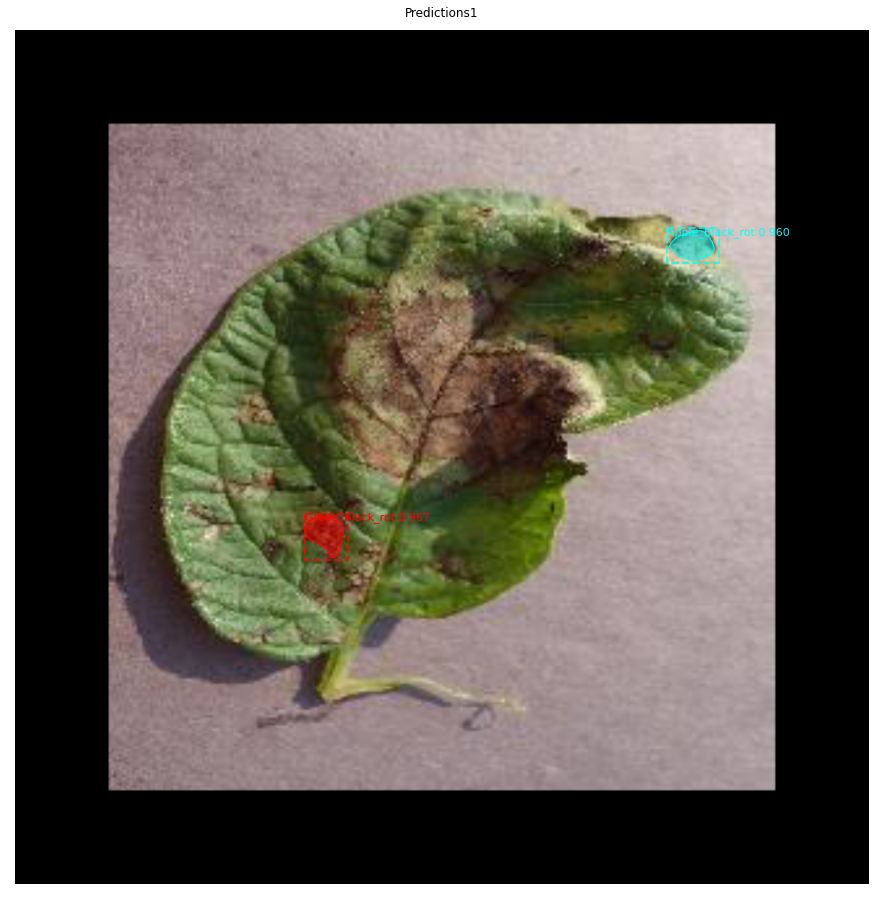

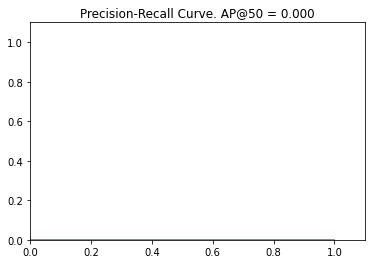

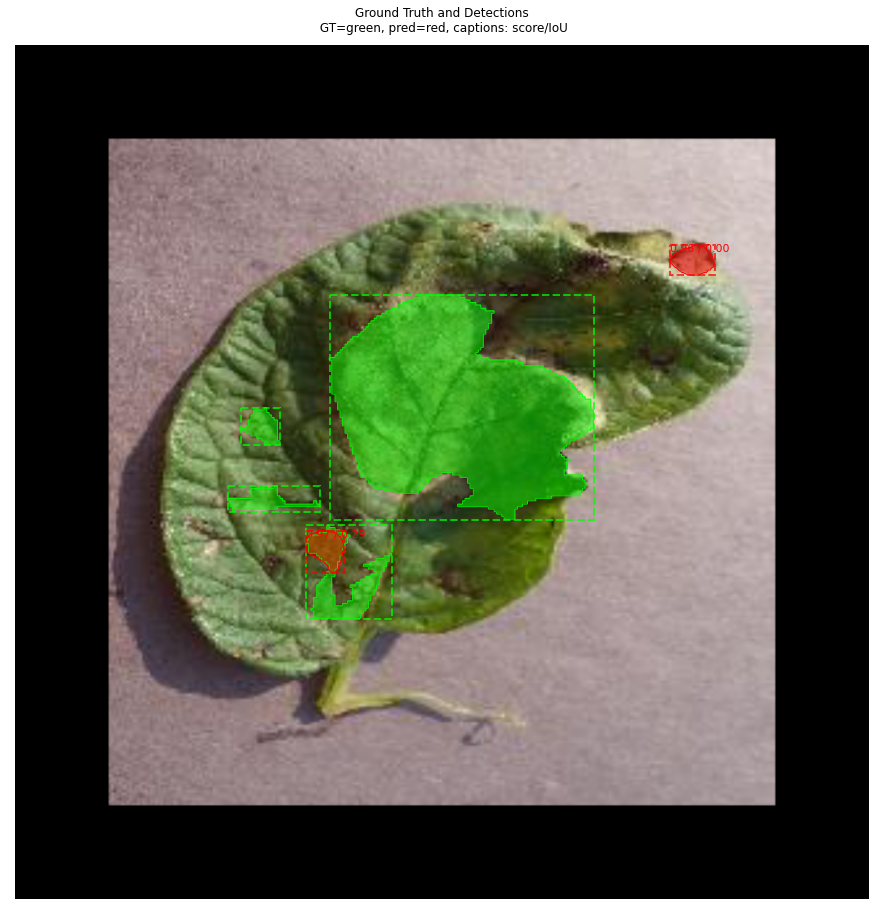

In [ ]:
# Displaying AveragePrecision and IOU's for all testing images
MAPs=[]
ious=[]
Precisions=[]
Recalls=[]
for id in range(36,len(dataset.image_ids)):
  image_id = id

  print("image id is :",image_id)

  image, image_meta, gt_class_id, gt_bbox, gt_mask =\
  modellib.load_image_gt(dataset,config,image_id,use_mini_mask=False)
  info = dataset.image_info[image_id]

  print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id,dataset.image_reference(image_id)))

  print("gt_class_id",gt_class_id)
  print("gt_class_id",type(gt_class_id))

  results = model_inference.detect([image], verbose=1)
  ax = get_ax(1)
  r1 = results[0]
  visualize.display_instances(image, r1['rois'], r1['masks'], r1['class_ids'],
  dataset.class_names, r1['scores'], ax=ax, title="Predictions1")
  AP, precisions, recall, _ = utils.compute_ap(gt_bbox, gt_class_id, gt_mask, r1["rois"],
                                           r1["class_ids"], r1["scores"], r1['masks'])
  visualize.plot_precision_recall(AP,precisions,recall)
  print("AP dimensions",AP)
  iou=utils.compute_overlaps_masks(r1['masks'],gt_mask)
  print('iou dimensions',np.sum(iou))
  iou=np.sum(iou)
  MAPs.append(np.mean(AP))
  ious.append(iou)
  Precisions.append(np.mean(precisions))
  Recalls.append(np.sum(recall))
  pred_boxes=utils.extract_bboxes(r1['masks'])

  visualize.display_differences(image,gt_bbox,gt_class_id,gt_mask,pred_boxes,r1['class_ids'],r1['scores'],r1['masks'],dataset.class_names)

In [ ]:
#Calculating mAP and IOU for overall images
dataset_val = CustomDataset()
dataset_val.load_custom("/content/New folder (4)/selectedimages/test", "test")
dataset_val.prepare()
config1 = CustomConfig()
model = modellib.MaskRCNN(mode="training", config=config1,model_dir=model_logs)

mean_average_precision_callback = modellib.MeanAveragePrecisionCallback(model,
model_inference, dataset_val, calculate_map_at_every_X_epoch=2, verbose=1)
b=mean_average_precision_callback._calculate_mean_average_precision()
print(b)




objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Apple_healthy']
numids [3]
objects: ['Apple_healthy']
numids [3]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Grape_healthy']
numids [4]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
objects: ['Potato_healthy']
numids [5]
obj

(0.701144181150529, 94.40732346568257)


1
Processing 1 images
image                    shape: (256, 256, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
1
Processing 1 images
image                    shape: (256, 256, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
1
Processing 1 images
image                    shape: (256, 256, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: 

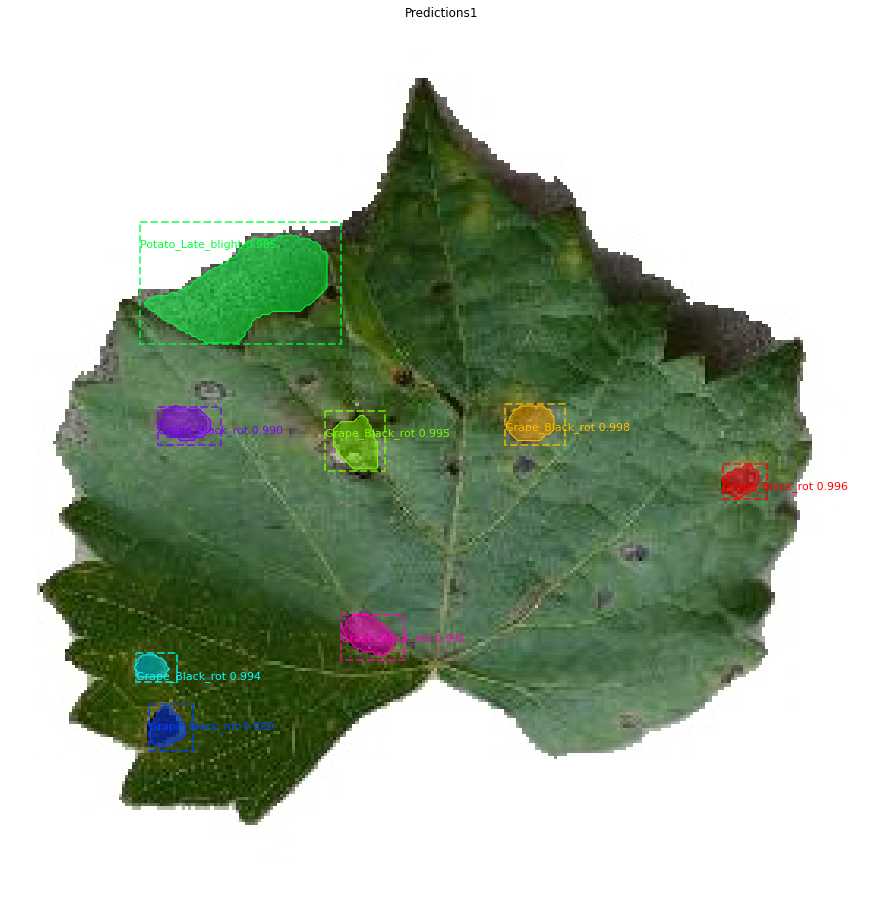

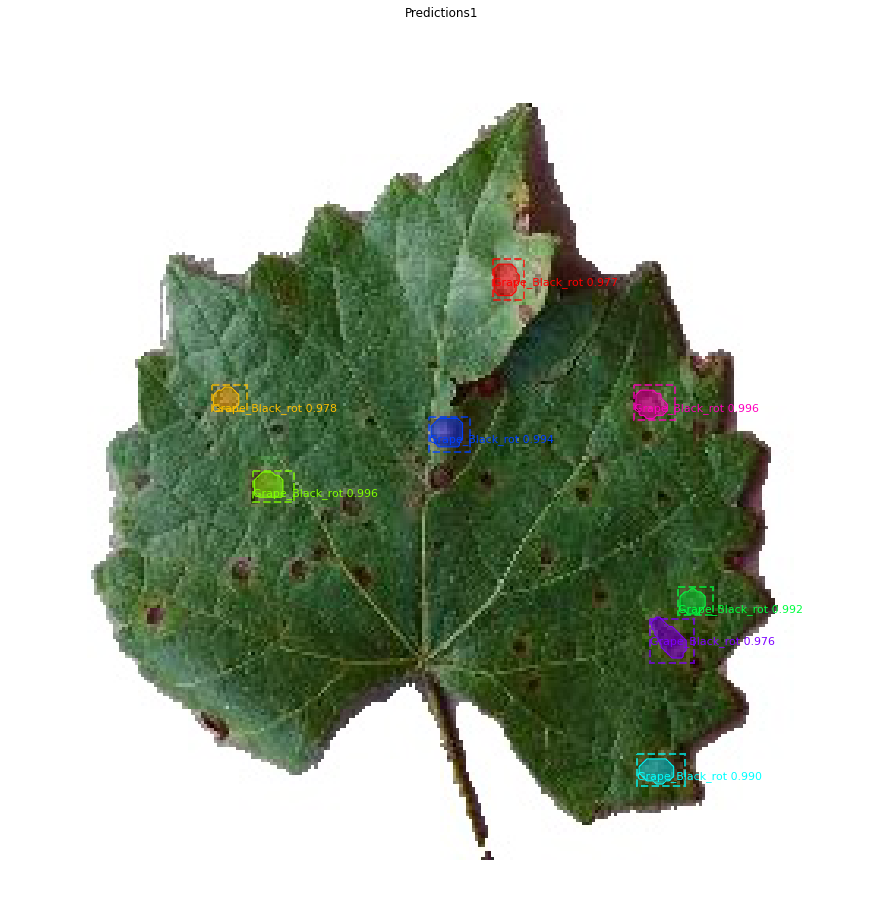

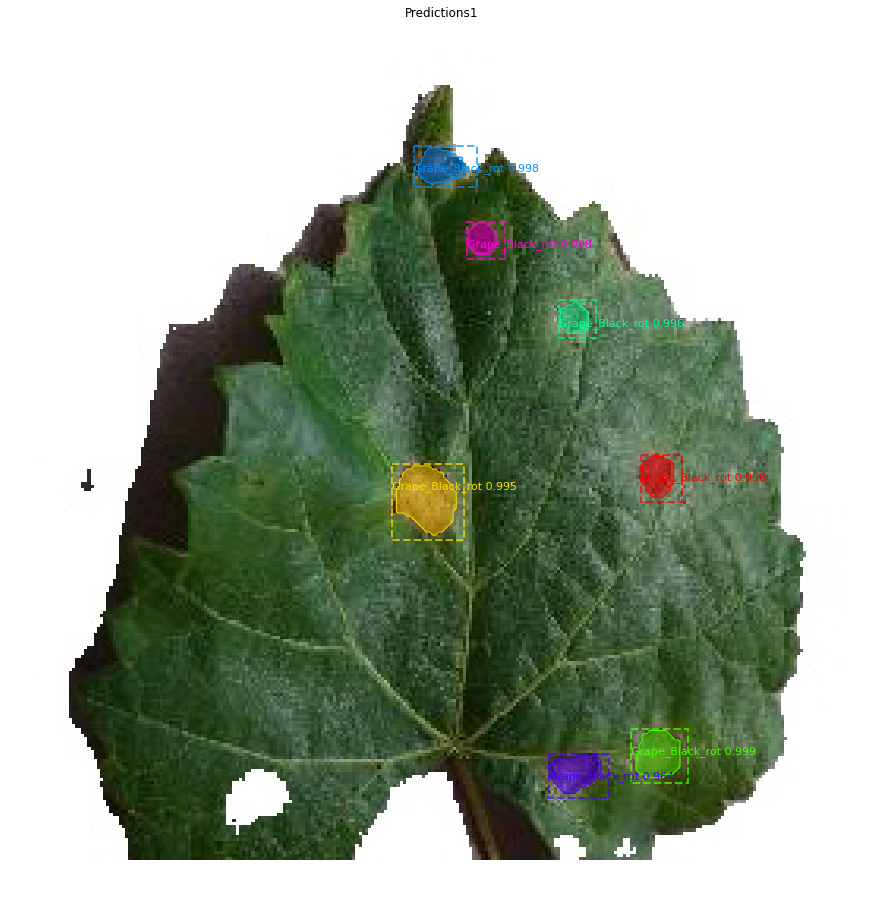

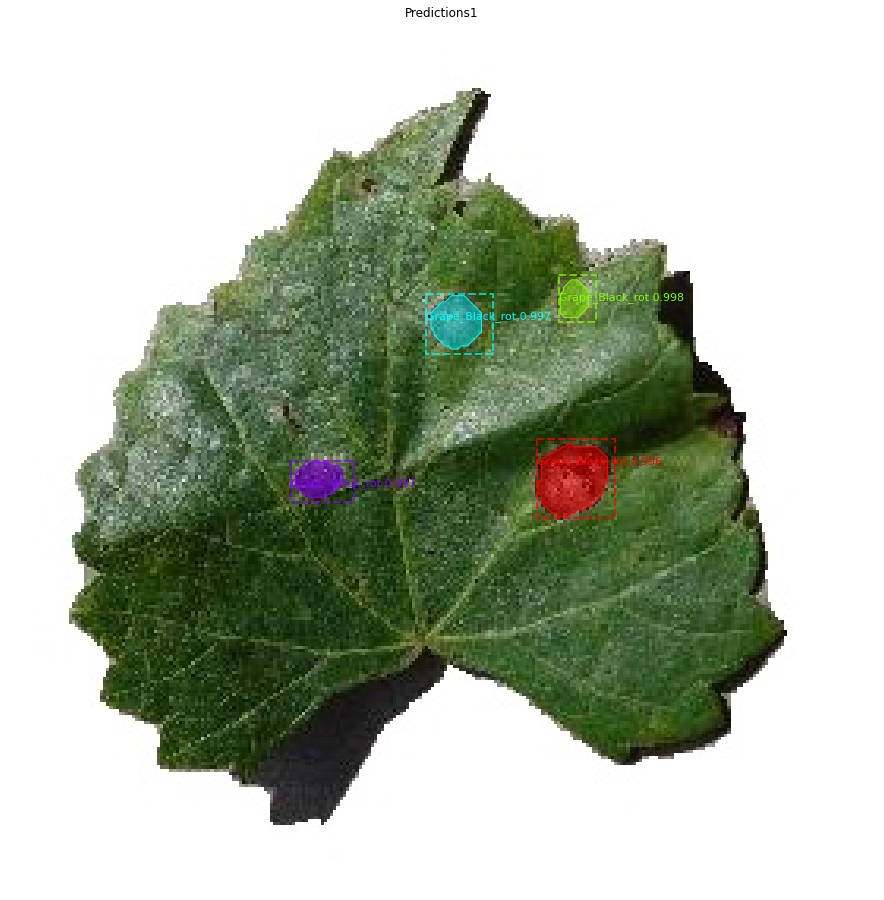

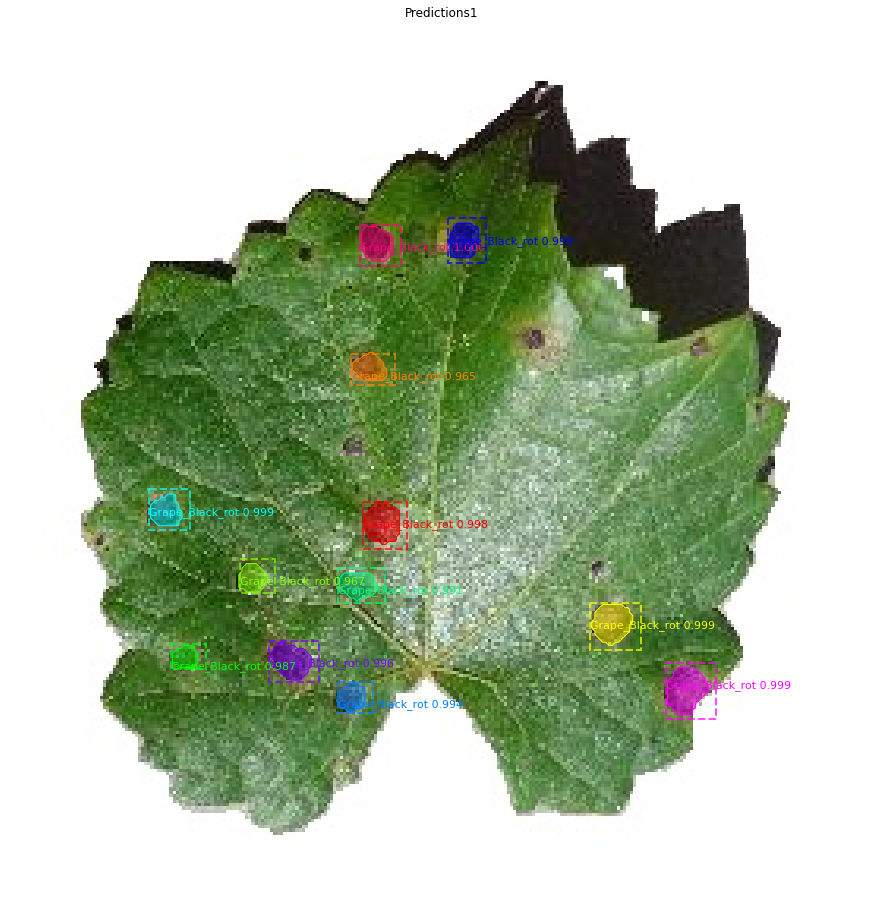

...

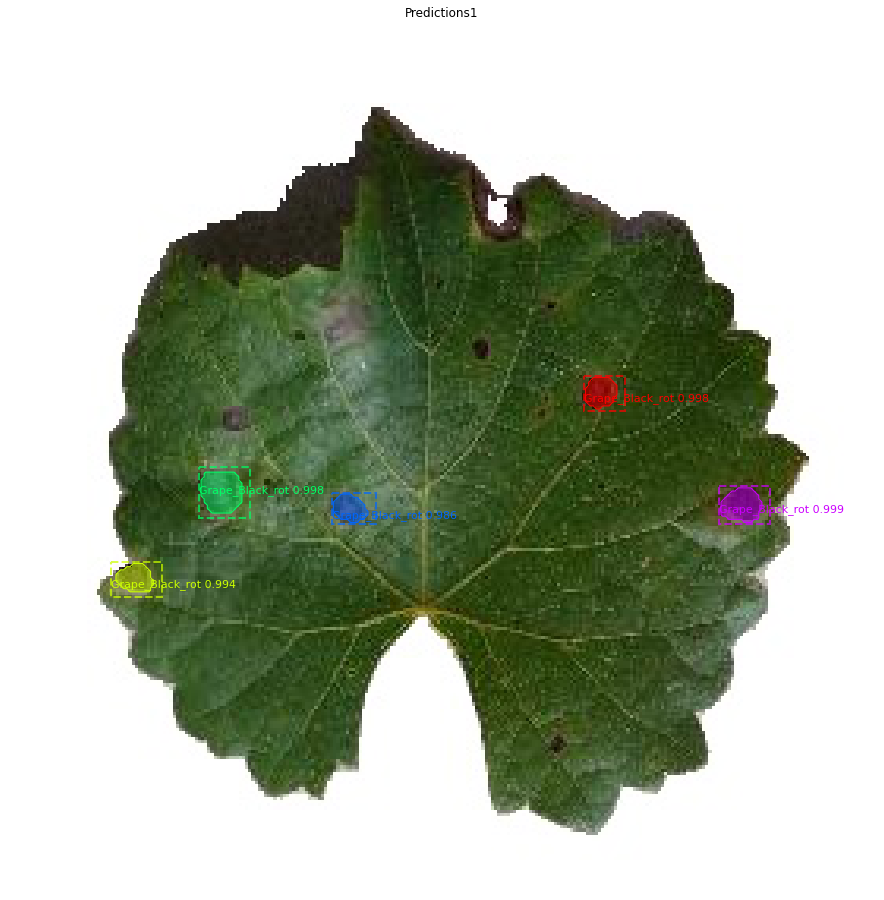

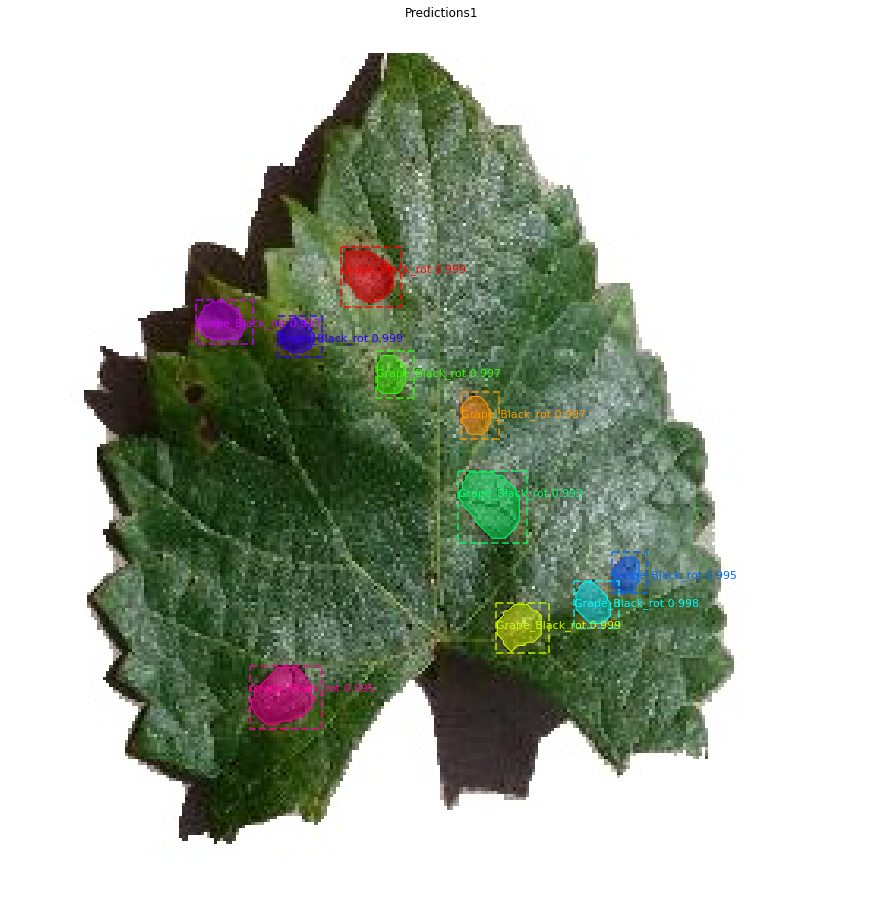

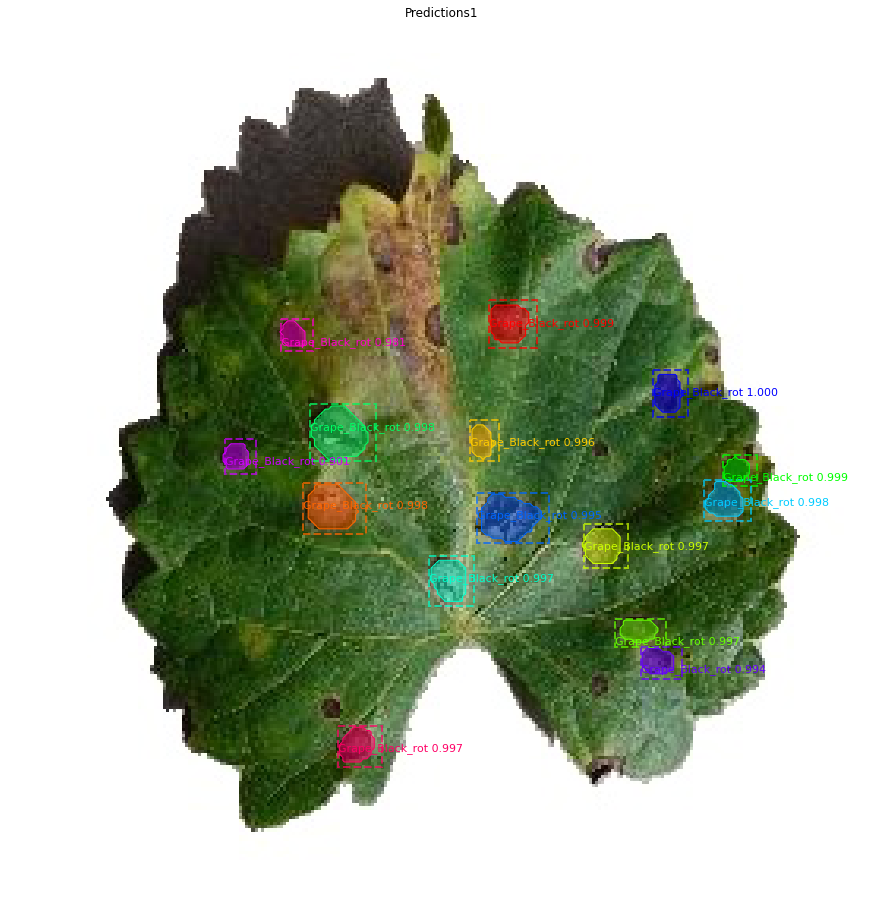

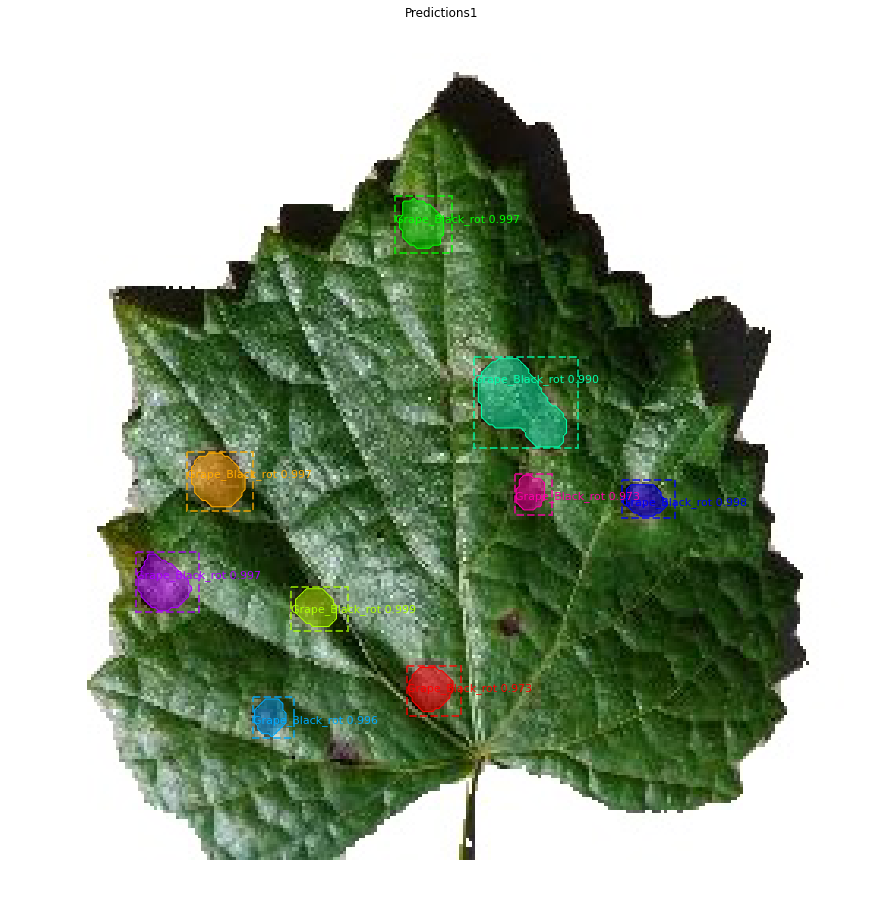

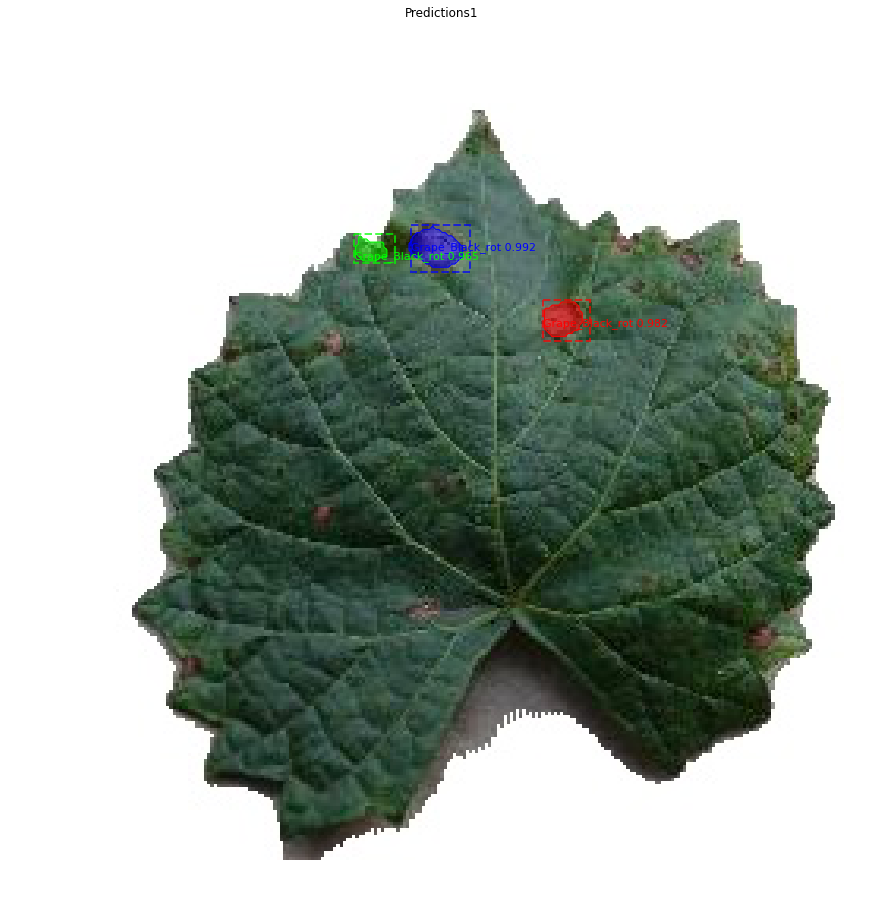

In [ ]:
# predicting DiseaseNames for images(white background)
lis=os.listdir("/content/without_background/Grape_Black_rot")
for x in lis:
  path="/content/without_background/Grape_Black_rot/"
  path_to_new_image = path+x
  image1 = mpimg.imread(path_to_new_image)


  print(len([image1]))
  results1 = model_inference.detect([image1], verbose=1)



  ax = get_ax(1)
  r1 = results1[0]
  visualize.display_instances(image1, r1['rois'], r1['masks'], r1['class_ids'],
  dataset.class_names, r1['scores'], ax=ax, title="Predictions1")

1
Processing 1 images
image                    shape: (197, 256, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  136.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
1
Processing 1 images
image                    shape: (225, 225, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
1
Processing 1 images
image                    shape: (194, 259, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max: 

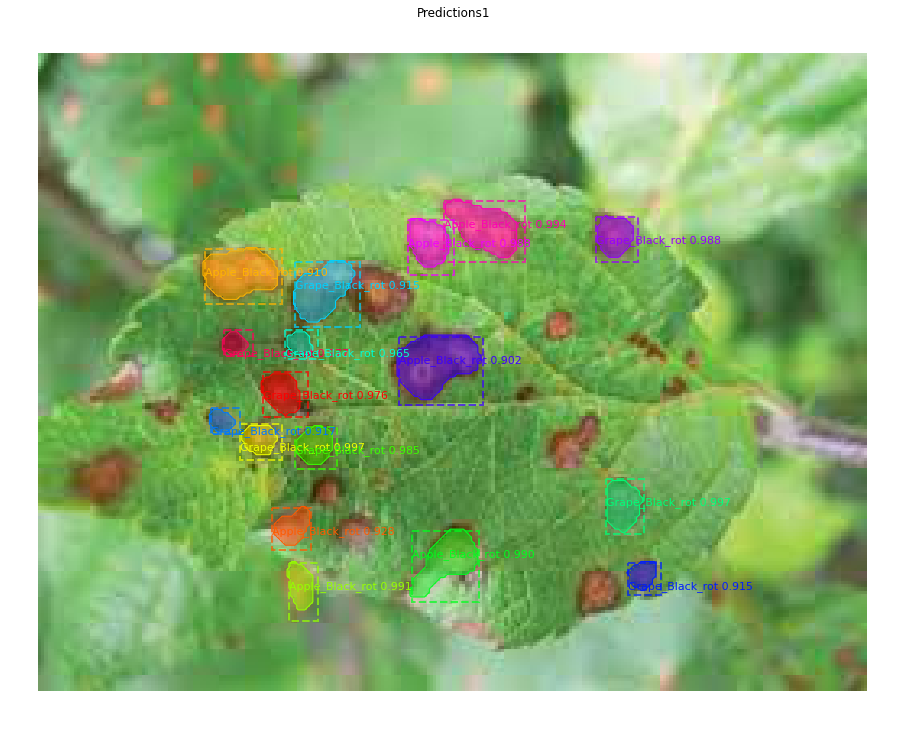

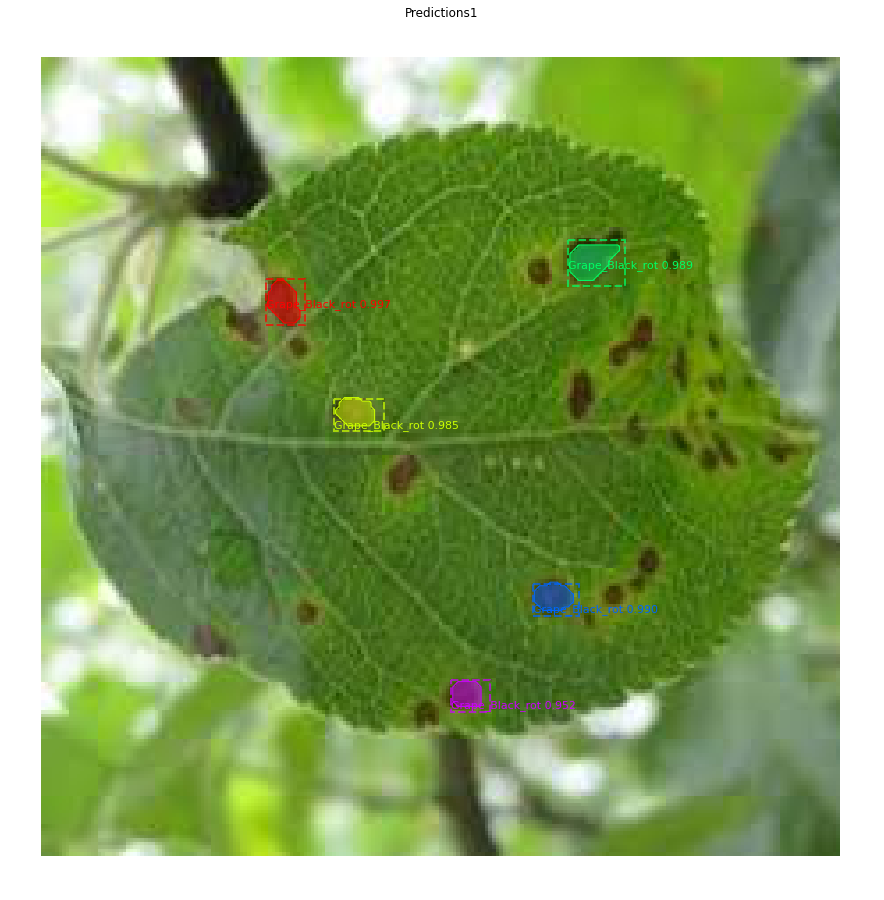

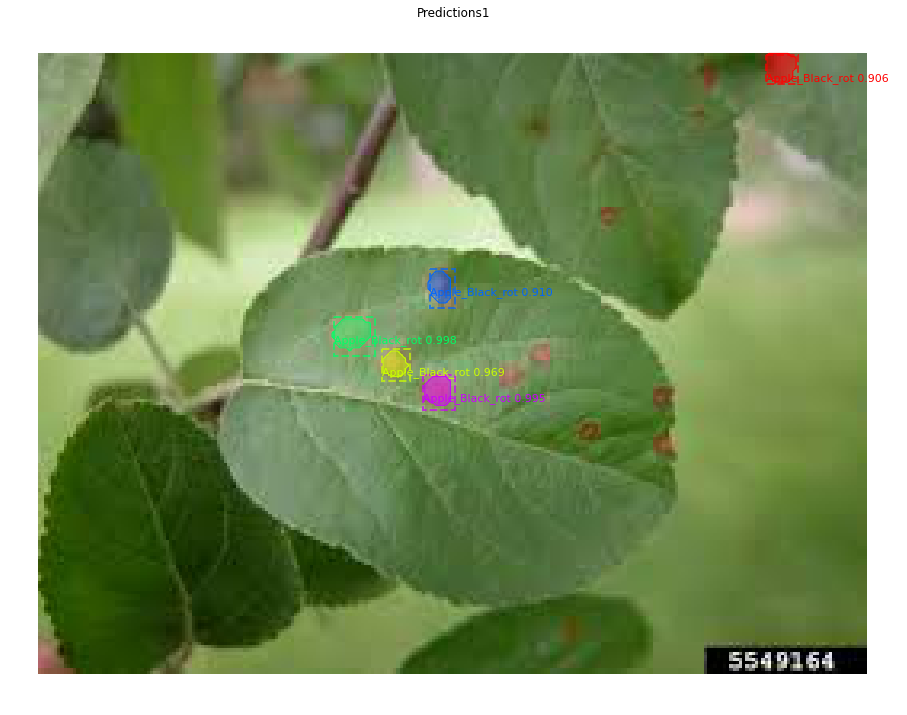

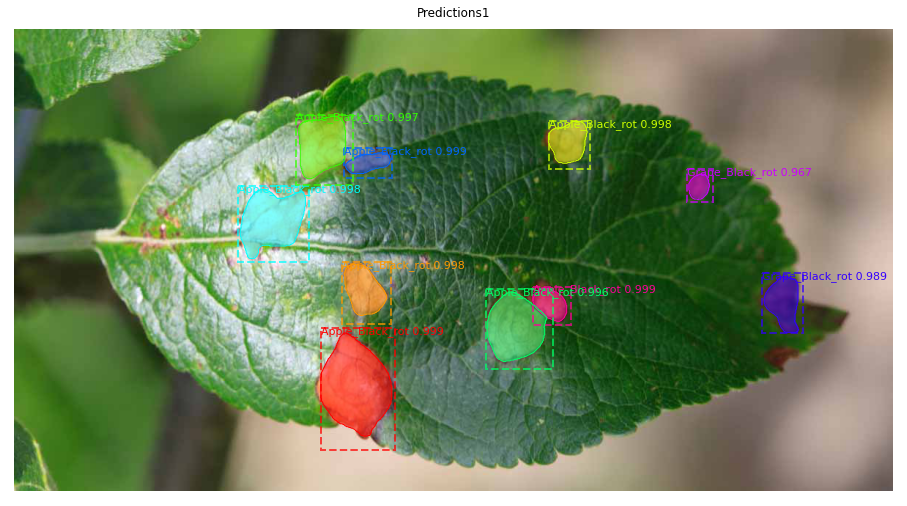

In [ ]:
# predicting DiseaseNames for images from online
lis=os.listdir("/content/images from online sources/apple_black_rot")
for x in lis:
  path="/content/images from online sources/apple_black_rot/"
  path_to_new_image = path+x
  image1 = mpimg.imread(path_to_new_image)


  print(len([image1]))
  results1 = model_inference.detect([image1], verbose=1)



  ax = get_ax(1)
  r1 = results1[0]
  visualize.display_instances(image1, r1['rois'], r1['masks'], r1['class_ids'],
  dataset.class_names, r1['scores'], ax=ax, title="Predictions1")

1
Processing 1 images
image                    shape: (178, 284, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  137.20000  float64
image_metas              shape: (1, 19)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32

*** No instances to display *** 



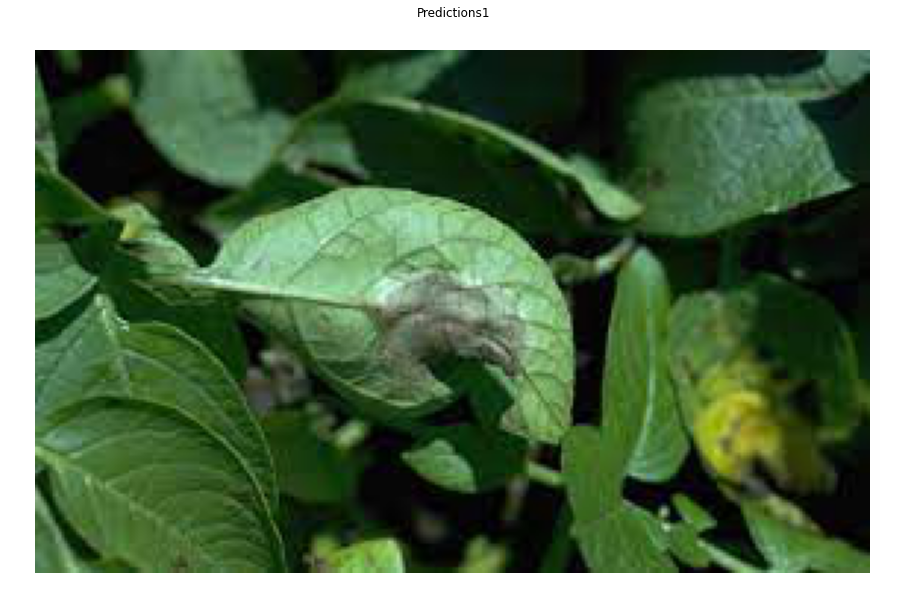

In [ ]:
#Predicting the disease name of one image from online sources
path_to_new_image = '/content/download (14).jfif'
image1 = mpimg.imread(path_to_new_image)

print(len([image1]))
results1 = model_inference.detect([image1], verbose=1)


# Display results
ax = get_ax(1)
r1 = results1[0]
visualize.display_instances(image1, r1['rois'], r1['masks'], r1['class_ids'],
dataset.class_names, r1['scores'], ax=ax, title="Predictions1")